<a href="https://colab.research.google.com/github/KatrinaJMD/DAFT_0410/blob/main/Witches.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

#### Initialization
![purple-divider](https://user-images.githubusercontent.com/7065401/52071927-c1cd7100-2562-11e9-908a-dde91ba14e59.png)

##### install libraries

In [ ]:
# install libraries
!pip install geopy
!pip install folium
!pip install pymysql
!pip install translate
!pip install sqlalchemy
!pip install folium pandas
!pip install geopandas pandas numpy shapely fiona

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.1/1.1 MB 16.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 16.0/16.0 MB 58.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 7.7/7.7 MB 84.9 MB/s eta 0:00:00


##### settings

In [ ]:
# libraries
import os
import re
import pytz
import math
import time
import json
import folium
import requests
import statistics
import collections
import numpy as np
import pandas as pd
import datetime as dt
from math import sqrt
from numpy import log
import seaborn as sns
from io import BytesIO
from scipy import stats
import geopandas as gpd
import scipy.stats as st
import matplotlib as mpl
import missingno as msno
from folium import plugins
import datetime as datetime
import plotly.express as px
from scipy.stats import norm
import statsmodels.api as sm
from datetime import datetime
import matplotlib.pyplot as plt
from matplotlib import rcParams
from matplotlib import gridspec
from collections import Counter
from sklearn import linear_model
from scipy.stats import chisquare
import matplotlib.dates as mdates
import plotly.graph_objects as go
from itertools import combinations
from folium.plugins import HeatMap
from IPython.display import display
from geopy.geocoders import Nominatim
import statsmodels.formula.api as smf
from sklearn.impute import KNNImputer
import numpy as np, warnings, itertools
from scipy.stats import chi2_contingency
from plotly.subplots import make_subplots
from scipy.stats import pearsonr, spearmanr
# from sklearn.impute import IterativeImputer
from statsmodels.tsa.stattools import adfuller
from pandas.plotting import autocorrelation_plot
from sklearn.experimental import enable_iterative_imputer
from sklearn.metrics import mean_absolute_error, mean_squared_error
%matplotlib inline

# params
pd.set_option('display.max_rows', None)
pd.set_option('display.max_columns', None)
pd.set_option('display.max_colwidth', None)
pd.options.display.float_format = '{:.2f}'.format

# mount drive
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


##### functions

In [ ]:
# most basic info
def getInfo(data):

    # check data info with detailed memory usage, cause why not..
    print("CHECK DATA INFO (WITH DETAILED MEMORY USGAE, CAUSE WHY NOT..)")
    print("-" * 109)
    print(f"{data.info(memory_usage='deep')}\n")
    print(f"{data.memory_usage(deep=True)}")

In [ ]:
# selective call to function
class dataProfiling:

    def moreInfo(self, data):    
        # more data info
        print(f"MORE DATA INFO :")
        print("-" * 109)

        print(f"Data shape : {data.shape}\n")

        # counts no. total values in the data
        print(f"No. of values in the dataset : {data.size:,}")

        # counts no. of rows
        print(f"Total rows in the dataset : {len(data):,}")

        # counts no. of columns
        print(f"Total columns in the dataset : {len(data.columns):,}")

        # counts no. of missing values
        print(f"\nTotal null values : {data.isnull().sum().sum():,}")

        # counts no. of duplicates
        countDuplicates = witch.duplicated().sum()
        print(f"Total duplicated rows : {format(countDuplicates, ',')}")

        # compute missing/duplicates ratio
        print(f"\nRATIO OF MISSING AND DUPLICATED VALUES IN OUR DATA :")
        print("-" * 109)

        # ratio for missing values
        isnull_ratio = (data.isnull().sum().sum() / data.size) * 100

        # ratio for duplicated values
        dup_ratio = (data.duplicated().sum() / len(data)) * 100

        # return results
        print(f"\nPercentage of null values in the data : {round(isnull_ratio, 2)}%")
        print(f"Percentage of duplicates in the data : {round(dup_ratio, 2)}%")
        print("\n")

    def valueCounts(self, data):
        # count no. of values per column
        print(f"\nCOUNT VALUES FOR EACH COLUMN :")
        print("-" * 109)
        for column in data.columns:
            countValues = data[column].value_counts(dropna=False).to_frame()
            totalValues = data[column].count()
            print(f"VALUE_COUNTS for column '{column}' : {len(countValues)} rows, {totalValues} values in Total\n")
            display(countValues)
            print("-" * 109)

    def nullColumns(self, data):
        # displays no. of missing values per column
        print(f"\nTOTAL MISSING VALUES FOR EACH COLUMN :")
        display(data.isnull().sum().to_frame().rename(columns={0: "MISSING VALUES"}))
        print("\n")

    def nullGroupby(self, data, column):
        # displays no. of missing values per category
        print(f"\nTOTAL MISSING VALUES PER COLUMN FOR EACH UNIQUE VALUE :")        
        display(data.isna().groupby(data[column]).sum())

        print("\n")
    def visualizeNulls(self, data):
        # visualize missing values
        print(f"VISAULIZE MISSNG VALUES :")
        print("-" * 109)

        # method 1
        print("METHOD 1")
        sns.heatmap(data.isnull().T,
                    xticklabels=False,
                    cmap="viridis",
                    cbar_kws={"label": "Missing Values"})

        plt.tight_layout()
        plt.show()
        print("\n")

        # method 2
        print("METHOD 2")
        plt.imshow(data.isna(), aspect="auto", interpolation="nearest", cmap="gray")
        plt.xlabel("Column Number")
        plt.ylabel("Sample Number");
        print("\n")

    def nullFeature(self, data, column):
        # displays rows where missing values are found of a specific column 
        print(f"DISPLAYS ROWS WHERE MISSING VALUES ARE FOUND OF A SPECIFIC FEATURE:")
        display(data[data[column].isna()])
        print("\n")

    def nullData(self, data):
        # displays rows where missing values are found
        print(f"DISPLAYS ROWS WHERE MISSING VALUES ARE FOUND :")
        display(data[data.isnull().any(axis=1)])
        print("\n")

    def allStats(self, data):
        # overall descerptive analysis (nuemrical and categorical)
        print(f"FULL DATA DESCRIPTIVE STATISTICS :")
        print("-" * 109)
        display(data.describe(include="all"))
        print("\n")

    def descriptiveData(self, data):
        # do quick descriptive statistics
        print(f"QUICK DESCRIPTIVE ANALYSIS :")
        print("-" * 109)
        display(data.describe())
        print("\n")

    def nonNumericStats(self, data):
        # categorical statistics
        print(f"NON-NUMERICAL STATISTICS :")
        print("-" * 109)
        display(data.describe(exclude="number"))
        print("\n")

    def uniqueColumns(self, data):
        # view all unique values for each column
        print(f"UNIQUE VALUES FOR EACH COLUMN :")
        print("-" * 109)

        for column in data.columns:
            uniqueValues = data[column].unique()
            uniqueCount = data[column].nunique()
            print(f"UNIQUE VALUES for column '{column}' : {len(uniqueValues)} including NaN values, {uniqueCount} excluding Nan values\n")
            print(f"{uniqueValues}\n")
            print("-" * 109)

    def plotUniques(self, data):
        # for each numerical feature compute number of unique entries
        unique_values = data.select_dtypes(include="number").nunique().sort_values()

        # plot information with y-axis in log-scale
        unique_values.plot.bar(logy=False, title="No. of unique values per feature", figsize=(25,7))
        plt.xticks(rotation=0)
        plt.tight_layout()
        plt.show()

# instance of the dataProfiling class
profiler = dataProfiling()

##### Loading dataset

In [ ]:
witch = pd.read_csv("/content/drive/MyDrive/[01] Data Analytics - IronHack/[06] Courses/Week 4/[Project 04] - Data Visualization/Trials.csv")
witch_backup = witch.copy()

## Data Profiling (*exploration*)

```python
# use these methods to analyze the data
profiler.moreInfo(data)
profiler.valueCounts(data)
profiler.nullColumns(data)
profiler.nullGroupby(data, column)
profiler.visualizeNulls(data)
profiler.nullFeature(data, column)
profiler.nullData(data)
profiler.descriptiveData(data)
profiler.nonNumericStats(data)
profiler.uniqueColumns(data)
profiler.plotUniques(data)
```

### Data info

In [ ]:
profiler.moreInfo(witch)

MORE DATA INFO :
-------------------------------------------------------------------------------------------------------------
Data shape : (10940, 12)

No. of values in the dataset : 131,280
Total rows in the dataset : 10,940
Total columns in the dataset : 12

Total null values : 22,782
Total duplicated rows : 3,884

RATIO OF MISSING AND DUPLICATED VALUES IN OUR DATA :
-------------------------------------------------------------------------------------------------------------

Percentage of null values in the data : 17.35%
Percentage of duplicates in the data : 35.5%




In [ ]:
profiler.descriptiveData(witch)

QUICK DESCRIPTIVE ANALYSIS :
-------------------------------------------------------------------------------------------------------------


,year,decade,century,tried,deaths,lon,lat
count,10009.00,10940.00,10940.00,10940.00,7114.00,5137.00,5137.00
mean,1621.06,1614.87,1569.20,3.95,2.30,8.29,48.55
std,66.25,66.68,72.61,19.26,16.30,2.89,1.65
min,1300.00,1300.00,1300.00,1.00,0.00,-3.53,41.39
25%,1597.00,1590.00,1500.00,1.00,0.00,6.15,47.73
50%,1630.00,1620.00,1600.00,1.00,0.00,8.77,48.53
75%,1660.00,1650.00,1600.00,1.00,1.00,10.49,49.76
max,1850.00,1850.00,1800.00,500.00,500.00,19.82,54.78


In [ ]:
profiler.nonNumericStats(witch)

NON-NUMERICAL STATISTICS :
-------------------------------------------------------------------------------------------------------------


,city,gadm.adm2,gadm.adm1,gadm.adm0,record.source
count,5727,9893,10781,10940,10940
unique,906,365,113,19,38
top,Geneva,Mittelfranken,Scotland,United Kingdom,Goodare et al. (2003)
freq,320,1303,3129,3750,3128


In [ ]:
profiler.nullColumns(witch)


TOTAL MISSING VALUES FOR EACH COLUMN :


,MISSING VALUES
year,931
decade,0
century,0
tried,0
deaths,3826
city,5213
gadm.adm2,1047
gadm.adm1,159
gadm.adm0,0
lon,5803


### Visualize info

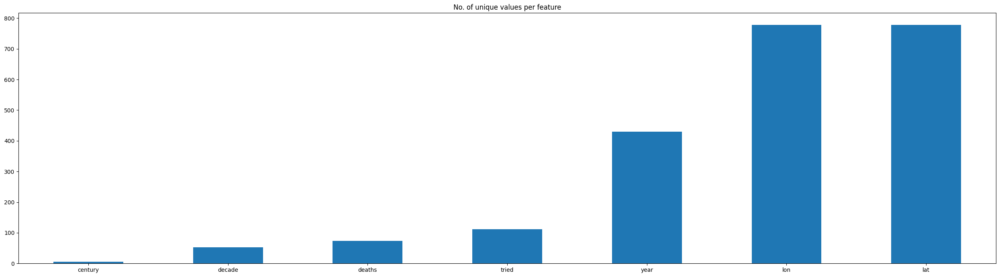

In [ ]:
profiler.plotUniques(witch)

VISAULIZE MISSNG VALUES :
-------------------------------------------------------------------------------------------------------------
METHOD 1


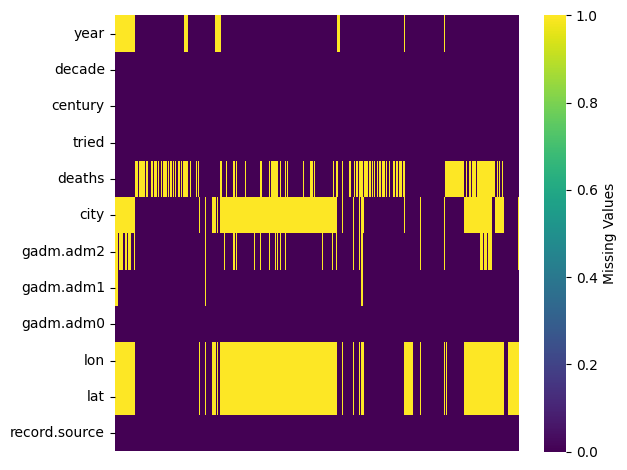



METHOD 2




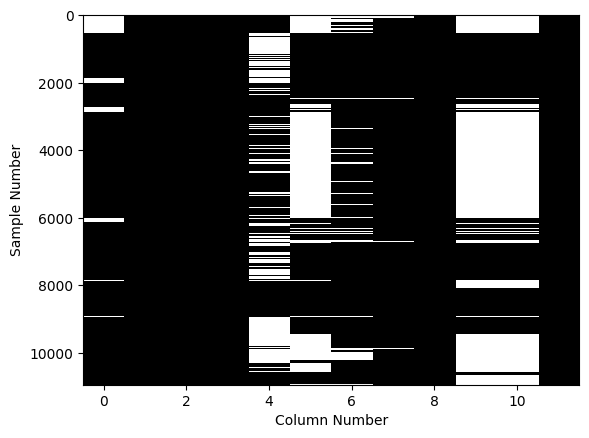

In [ ]:
profiler.visualizeNulls(witch)

## Data Validation (*cleaning*)

### Rename columns

In [ ]:
witch.rename(columns={"tried": "trials",
                       "gadm.adm0": "country",
                       "gadm.adm1": "region",
                       "gadm.adm2": "department"}, inplace=True)
witch.head()

,year,decade,century,trials,deaths,city,department,region,country,lon,lat,record.source
0,NaN,1520,1500,1,1.00,NaN,NaN,NaN,Estonia,NaN,NaN,Madar (1990)
1,NaN,1530,1500,1,1.00,NaN,NaN,NaN,Estonia,NaN,NaN,Madar (1990)
2,NaN,1540,1500,5,5.00,NaN,NaN,NaN,Estonia,NaN,NaN,Madar (1990)
3,NaN,1580,1500,7,5.00,NaN,NaN,NaN,Estonia,NaN,NaN,Madar (1990)
4,NaN,1590,1500,11,0.00,NaN,NaN,NaN,Estonia,NaN,NaN,Madar (1990)


### Remove duplicates

In [ ]:
duplicates = witch[witch.duplicated(keep=False)]
duplicates

,year,decade,century,trials,deaths,city,department,region,country,lon,lat,record.source
847,1597.00,1590,1500,1,NaN,Augsburg,Mittelfranken,Bayern,Germany,10.90,48.37,Behringer (1987)
854,1597.00,1590,1500,1,NaN,Augsburg,Mittelfranken,Bayern,Germany,10.90,48.37,Behringer (1987)
892,1605.00,1600,1600,1,NaN,Augsburg,Mittelfranken,Bayern,Germany,10.90,48.37,Behringer (1987)
898,1605.00,1600,1600,1,NaN,Augsburg,Mittelfranken,Bayern,Germany,10.90,48.37,Behringer (1987)
979,1612.00,1610,1600,1,NaN,Munich,Mittelfranken,Bayern,Germany,11.58,48.14,Behringer (1987)
980,1612.00,1610,1600,1,NaN,Munich,Mittelfranken,Bayern,Germany,11.58,48.14,Behringer (1987)
1020,1615.00,1610,1600,1,NaN,Munich,Mittelfranken,Bayern,Germany,11.58,48.14,Behringer (1987)
1023,1615.00,1610,1600,1,NaN,Munich,Mittelfranken,Bayern,Germany,11.58,48.14,Behringer (1987)
1131,1629.00,1620,1600,1,NaN,Dachau,Mittelfranken,Bayern,Germany,11.43,48.26,Behringer (1987)
1132,1629.00,1620,1600,1,NaN,Dachau,Mittelfranken,Bayern,Germany,11.43,48.26,Behringer (1987)


In [ ]:
# method 1
method1 = witch[~witch.duplicated()]
display(method1.shape, method1.size)

# method 2
witch.drop_duplicates(inplace=True)
display(witch.shape, witch.size)

(7056, 12)

84672

(7056, 12)

84672

### Fill NaN values

In [ ]:
profiler.nullGroupby(witch, "country")


TOTAL MISSING VALUES PER COLUMN FOR EACH UNIQUE VALUE :


,year,decade,century,trials,deaths,city,department,region,country,lon,lat,record.source
country,,,,,,,,,,,,
Austria,0,0,0,0,11,6,6,4,0,6,6,0
Belgium,50,0,0,0,74,26,0,0,0,124,124,0
Czech Republic,0,0,0,0,1,0,0,0,0,0,0,0
Denmark,0,0,0,0,57,6,6,6,0,57,57,0
Estonia,17,0,0,0,0,17,17,17,0,17,17,0
Finland,17,0,0,0,0,17,17,17,0,17,17,0
France,225,0,0,0,196,161,76,52,0,189,189,0
Germany,91,0,0,0,1593,265,59,4,0,289,289,0
Hungary,26,0,0,0,0,26,26,26,0,26,26,0


#### **year** column

In [ ]:
profiler.nullFeature(witch, "year")

DISPLAYS ROWS WHERE MISSING VALUES ARE FOUND OF A SPECIFIC FEATURE:


,year,decade,century,trials,deaths,city,department,region,country,lon,lat,record.source
0,NaN,1520,1500,1,1.00,NaN,NaN,NaN,Estonia,NaN,NaN,Madar (1990)
1,NaN,1530,1500,1,1.00,NaN,NaN,NaN,Estonia,NaN,NaN,Madar (1990)
2,NaN,1540,1500,5,5.00,NaN,NaN,NaN,Estonia,NaN,NaN,Madar (1990)
3,NaN,1580,1500,7,5.00,NaN,NaN,NaN,Estonia,NaN,NaN,Madar (1990)
4,NaN,1590,1500,11,0.00,NaN,NaN,NaN,Estonia,NaN,NaN,Madar (1990)
5,NaN,1600,1600,6,1.00,NaN,NaN,NaN,Estonia,NaN,NaN,Madar (1990)
6,NaN,1610,1600,22,18.00,NaN,NaN,NaN,Estonia,NaN,NaN,Madar (1990)
7,NaN,1620,1600,14,8.00,NaN,NaN,NaN,Estonia,NaN,NaN,Madar (1990)
8,NaN,1630,1600,25,4.00,NaN,NaN,NaN,Estonia,NaN,NaN,Madar (1990)
9,NaN,1640,1600,39,10.00,NaN,NaN,NaN,Estonia,NaN,NaN,Madar (1990)


In [ ]:
# custom aggregation function to calculate the mode
def mode(x):
    mode_result = stats.mode(x, nan_policy='omit')
    if mode_result.count[0] > 0:
        return mode_result.mode[0]
    else:
        return np.nan

years = witch[["country", "year"]].pivot_table(index=["country"], values="year", aggfunc=["min", "max", "mean", mode])
years

<ipython-input-113-57a7809c0ca5>:3: FutureWarning:

Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.



,min,max,mean,mode
,year,year,year,year
country,,,,
Austria,1315.00,1689.00,1466.44,1315.00
Belgium,1389.00,1684.00,1585.10,1601.00
Czech Republic,1350.00,1350.00,1350.00,1350.00
Denmark,1572.00,1652.00,1618.09,1620.00
France,1303.00,1745.00,1536.10,1610.00
Germany,1300.00,1792.00,1623.34,1590.00
Ireland,1324.00,1661.00,1535.25,1578.00
Italy,1320.00,1650.00,1535.48,1375.00


In [ ]:
mask = witch["year"].isnull()
witch.loc[mask, "year"] = witch.loc[mask, "decade"]

profiler.nullColumns(witch)


TOTAL MISSING VALUES FOR EACH COLUMN :


,MISSING VALUES
year,0
decade,0
century,0
trials,0
deaths,2930
city,2460
department,848
region,158
country,0
lon,2914


#### **deaths** column

In [ ]:
profiler.nullFeature(witch, "deaths")

In [ ]:
deaths = witch[["country", "deaths"]].pivot_table(index=["country"], values="deaths", aggfunc=["min", "max", "mean", mode])
deaths

In [ ]:
witch.groupby("country")[["deaths"]].count().sort_values(by="deaths", ascending=False)

,deaths
country,
Germany,1382
Switzerland,798
United Kingdom,603
France,472
Belgium,428
Netherlands,299
Italy,28
Hungary,26
Norway,20


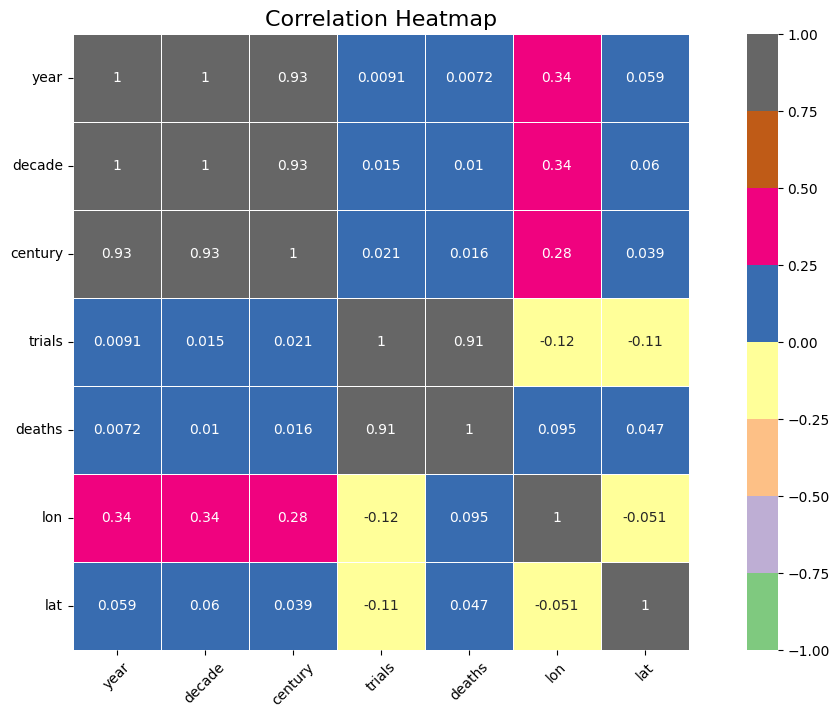

In [ ]:
corrMatrix = witch.corr(numeric_only=True)

plt.figure(figsize=(15, 8))

ax = sns.heatmap(
    corrMatrix,
    annot=True,
    cmap="Accent",
    vmin=-1, vmax=1,
    linewidths=0.5,
    square=True)

# heatmap appearance
ax.set_title("Correlation Heatmap", fontsize=16)
plt.xticks(rotation=45)
plt.yticks(rotation=0) 

# plot
plt.show()

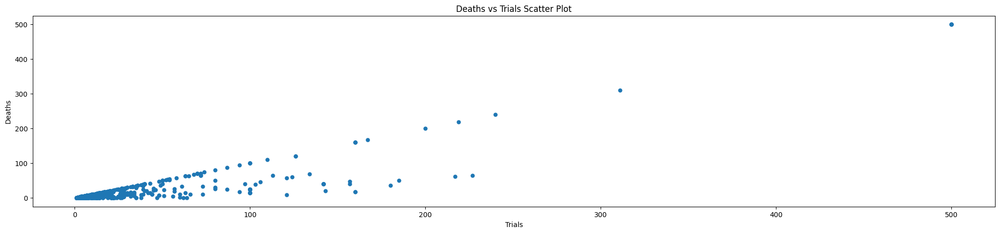

In [ ]:
plt.figure(figsize=(25,5))
plt.scatter(witch["trials"], witch["deaths"], s=25)
plt.xlabel("Trials")
plt.ylabel("Deaths")
plt.title("Deaths vs Trials Scatter Plot")
plt.show()

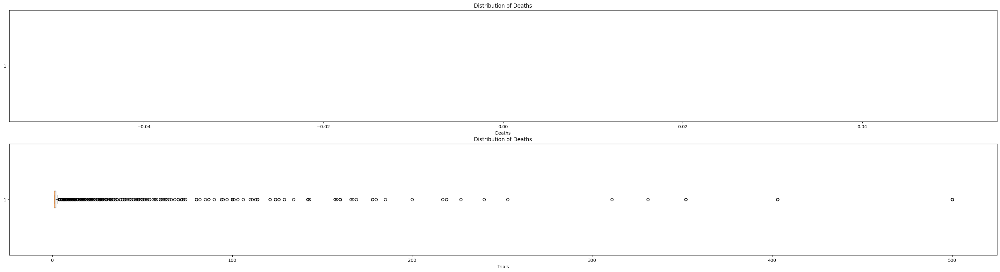

In [ ]:
fig, axes = plt.subplots(2, 1, figsize=(40, 10))

# box plot for deaths
axes[0].boxplot(witch["deaths"], vert=False)
axes[0].set_xlabel("Deaths")
axes[0].set_title("Distribution of Deaths")

# box plot for trials
axes[1].boxplot(witch["trials"], vert=False)
axes[1].set_xlabel("Trials")
axes[1].set_title("Distribution of Deaths")

plt.show()

In [ ]:
imputer = KNNImputer(n_neighbors=5)
imputeDeaths = imputer.fit_transform(witch[["deaths"]])
witch.loc[:, "deaths"] = imputeDeaths

profiler.nullColumns(witch)


TOTAL MISSING VALUES FOR EACH COLUMN :


,MISSING VALUES
year,0
decade,0
century,0
trials,0
deaths,0
city,2460
department,848
region,158
country,0
lon,2914


#### **location** columns (*city, department, region*)

In [ ]:
witch.groupby(["country"])["city", "region", "department"].agg(pd.Series.mode)

##### **Austria**

In [ ]:
austria = witch[witch["country"]=="Austria"].sort_values(by="decade")
austria

,year,decade,century,trials,deaths,city,department,region,country,lon,lat,record.source
6496,1315.00,1310,1300,1,3.85,Krems,Krems an der Donau Land,Niederosterreich,Austria,15.60,48.41,Kieckhefer (1976)
6678,1323.00,1320,1300,1,3.85,NaN,NaN,NaN,Austria,NaN,NaN,Kieckhefer (1976)
6679,1326.00,1320,1300,1,3.85,NaN,NaN,NaN,Austria,NaN,NaN,Kieckhefer (1976)
6681,1327.00,1320,1300,1,3.85,NaN,NaN,NaN,Austria,NaN,NaN,Kieckhefer (1976)
6683,1338.00,1330,1300,1,3.85,NaN,NaN,NaN,Austria,NaN,NaN,Kieckhefer (1976)
6578,1340.00,1340,1300,1,3.85,Salzburg,Salzburg,Salzburg,Austria,13.06,47.81,Kieckhefer (1976)
6592,1433.00,1430,1400,2,0.00,NaN,NaN,Tirol,Austria,NaN,NaN,Kieckhefer (1976)
6593,1436.00,1430,1400,1,0.00,NaN,NaN,Tirol,Austria,NaN,NaN,Kieckhefer (1976)
6594,1485.00,1480,1400,57,3.85,Innsbruck,Innsbruck,Tirol,Austria,11.40,47.27,Kieckhefer (1976)
1861,1495.00,1490,1400,1,3.85,Braunau am Inn,Braunau am Inn,Oberosterreich,Austria,13.04,48.26,Behringer (1987)


In [ ]:
austria.groupby("century")[["region", "department", "city"]].count()

,region,department,city
century,,,
1300,2,2,2
1400,5,3,3
1500,1,1,1
1600,4,4,4


In [ ]:
# Tirol region
witch.loc[(witch["country"] == "Austria") & (witch["region"] == "Tirol") & (witch["city"].isna()), "city"] = "Innsbruck"
witch.loc[(witch["country"] == "Austria") & (witch["region"] == "Tirol") & (witch["department"].isna()), "department"] = "Innsbruck"

# NaN region, department, and city in the 1320
witch.loc[(witch["country"] == "Austria") &
          (witch["region"].isna()) &
          (witch["department"].isna()) &
          (witch["city"].isna()) &
          (witch["decade"] == 1320),
          ["region", "department", "city"]] = ["Niederosterreich", "Krems an der Donau Land", "Krems"]

# NaN region, department, and city in the 1330
witch.loc[(witch["country"] == "Austria") &
          (witch["region"].isna()) &
          (witch["department"].isna()) &
          (witch["city"].isna()) &
          (witch["decade"] == 1330),
          ["region", "department", "city"]] = ["Salzburg", "Salzburg", "Salzburg"]

witch[witch["country"]=="Austria"]

,year,decade,century,trials,deaths,city,department,region,country,lon,lat,record.source
1861,1495.00,1490,1400,1,3.85,Braunau am Inn,Braunau am Inn,Oberosterreich,Austria,13.04,48.26,Behringer (1987)
1862,1607.00,1600,1600,1,3.85,Scharding,Braunau am Inn,Oberosterreich,Austria,13.43,48.46,Behringer (1987)
1863,1625.00,1620,1600,1,1.00,Braunau am Inn,Braunau am Inn,Oberosterreich,Austria,13.04,48.26,Behringer (1987)
1864,1646.00,1640,1600,1,3.85,Mattighofen,Braunau am Inn,Oberosterreich,Austria,13.15,48.11,Behringer (1987)
1865,1689.00,1680,1600,1,3.85,Mattighofen,Braunau am Inn,Oberosterreich,Austria,13.15,48.11,Behringer (1987)
6496,1315.00,1310,1300,1,3.85,Krems,Krems an der Donau Land,Niederosterreich,Austria,15.60,48.41,Kieckhefer (1976)
6578,1340.00,1340,1300,1,3.85,Salzburg,Salzburg,Salzburg,Austria,13.06,47.81,Kieckhefer (1976)
6592,1433.00,1430,1400,2,0.00,Innsbruck,Innsbruck,Tirol,Austria,NaN,NaN,Kieckhefer (1976)
6593,1436.00,1430,1400,1,0.00,Innsbruck,Innsbruck,Tirol,Austria,NaN,NaN,Kieckhefer (1976)
6594,1485.00,1480,1400,57,3.85,Innsbruck,Innsbruck,Tirol,Austria,11.40,47.27,Kieckhefer (1976)


##### **Belgium**

In [ ]:
belgium = witch[witch["country"]=="Belgium"].sort_values(by="decade")
belgium

,year,decade,century,trials,deaths,city,department,region,country,lon,lat,record.source
6283,1389.00,1380,1300,1,0.00,Brussels,Bruxelles,Bruxelles,Belgium,4.35,50.85,Kieckhefer (1976)
6657,1417.00,1410,1400,1,0.00,Tournai,Hainaut,Wallonie,Belgium,3.39,50.61,Kieckhefer (1976)
6658,1459.00,1450,1400,1,3.85,Nivelles,Brabant Wallon,Wallonie,Belgium,4.33,50.60,Kieckhefer (1976)
7917,1459.00,1450,1400,1,1.00,Bruges,West-Vlaanderen,Vlaanderen,Belgium,NaN,NaN,Monballyu (2002)
10549,1468.00,1460,1400,1,1.00,Bruges,West-Vlaanderen,Vlaanderen,Belgium,3.22,51.21,Vanysacker (1988)
6659,1468.00,1460,1400,1,3.85,Bruges,West-Vlaanderen,Wallonie,Belgium,3.22,51.21,Kieckhefer (1976)
7918,1468.00,1460,1400,1,1.00,Bruges,West-Vlaanderen,Vlaanderen,Belgium,NaN,NaN,Monballyu (2002)
7920,1468.00,1460,1400,1,1.00,Diksmuide,West-Vlaanderen,Vlaanderen,Belgium,NaN,NaN,Monballyu (2002)
6660,1472.00,1470,1400,2,3.85,Tournai,Hainaut,Wallonie,Belgium,3.39,50.61,Kieckhefer (1976)
10552,1495.00,1490,1400,2,0.00,Bruges,West-Vlaanderen,Vlaanderen,Belgium,3.22,51.21,Vanysacker (1988)


In [ ]:
belgium.groupby(["department"])["city", "region"].agg(pd.Series.mode)

<ipython-input-127-bbc18e574bc8>:1: FutureWarning:

Indexing with multiple keys (implicitly converted to a tuple of keys) will be deprecated, use a list instead.



,city,region
department,,
Antwerpen,Machelen,Vlaanderen
Brabant Wallon,Villers-la-Ville,Wallonie
Bruxelles,Brussels,Bruxelles
Hainaut,Fleurus,Wallonie
Liege,"[Braives, Hannut]",Wallonie
Luxembourg,Durbuy,Wallonie
Namur,Namur,Wallonie
Oost-Vlaanderen,Ghent,Vlaanderen
Vlaams Brabant,Liedekerke,Vlaanderen


In [ ]:
witch.loc[(witch["country"] == "Belgium") & (witch["department"] == "Namur") & (witch["city"].isna()), "city"] = "Spa"

witch[witch["country"]=="Belgium"]

,year,decade,century,trials,deaths,city,department,region,country,lon,lat,record.source
1998,1509.00,1500,1500,1,1.00,Onhaye,Namur,Wallonie,Belgium,4.84,50.24,Brouette (1953)
1999,1509.00,1500,1500,1,1.00,Floreffe,Namur,Wallonie,Belgium,4.76,50.43,Brouette (1953)
2000,1509.00,1500,1500,1,1.00,Walcourt,Namur,Wallonie,Belgium,4.43,50.25,Brouette (1953)
2001,1510.00,1510,1500,2,0.00,Dinant,Namur,Wallonie,Belgium,4.91,50.26,Brouette (1953)
2002,1510.00,1510,1500,1,3.85,Spa,Namur,Wallonie,Belgium,NaN,NaN,Brouette (1953)
2004,1511.00,1510,1500,2,3.85,Spa,Namur,Wallonie,Belgium,NaN,NaN,Brouette (1953)
2005,1512.00,1510,1500,1,1.00,Floreffe,Namur,Wallonie,Belgium,4.76,50.43,Brouette (1953)
2006,1514.00,1510,1500,1,0.00,Andenne,Namur,Wallonie,Belgium,5.10,50.49,Brouette (1953)
2007,1516.00,1510,1500,1,1.00,Braives,Liege,Wallonie,Belgium,5.15,50.63,Brouette (1953)
2008,1517.00,1510,1500,1,1.00,Namur,Namur,Wallonie,Belgium,4.87,50.47,Brouette (1953)


##### **Denmark**

In [ ]:
denmark = witch[witch["country"]=="Denmark"].sort_values(by="decade")
denmark

,year,decade,century,trials,deaths,city,department,region,country,lon,lat,record.source
10215,1572.00,1570,1500,1,3.85,Bramming,Bramming,Ribe,Denmark,NaN,NaN,Tornso (1986)
10216,1572.00,1570,1500,1,3.85,Ribe,Ribe,Ribe,Denmark,NaN,NaN,Tornso (1986)
10217,1577.00,1570,1500,1,3.85,Ribe,Ribe,Ribe,Denmark,NaN,NaN,Tornso (1986)
10220,1578.00,1570,1500,1,3.85,Ribe,Ribe,Ribe,Denmark,NaN,NaN,Tornso (1986)
10221,1590.00,1590,1500,1,3.85,Ribe,Ribe,Ribe,Denmark,NaN,NaN,Tornso (1986)
10223,1595.00,1590,1500,1,3.85,Ribe,Ribe,Ribe,Denmark,NaN,NaN,Tornso (1986)
10237,1614.00,1610,1600,1,3.85,Ribe,Ribe,Ribe,Denmark,NaN,NaN,Tornso (1986)
10245,1617.00,1610,1600,1,3.85,Esbjerg,Esbjerg,Ribe,Denmark,NaN,NaN,Tornso (1986)
10247,1617.00,1610,1600,1,3.85,Varde,Varde,Ribe,Denmark,NaN,NaN,Tornso (1986)
10253,1618.00,1610,1600,1,3.85,Esbjerg,Esbjerg,Ribe,Denmark,NaN,NaN,Tornso (1986)


In [ ]:
denmark.groupby("century")[["region", "department", "city"]].count()

,region,department,city
century,,,
1500,6,6,6
1600,45,45,45


In [ ]:
denmark.loc[denmark["century"] == 1600].groupby(["decade"])[["city", "department", "region"]].agg(pd.Series.mode)

,city,department,region
decade,,,
1610,Varde,Varde,Ribe
1620,"[Esbjerg, Haderslev]","[Esbjerg, Haderslev]",Ribe
1630,Norre-Nebel,Blaabjerg,Ribe
1640,Ribe,Ribe,Ribe
1650,Ribe,Ribe,Ribe


In [ ]:
# decade 1610
witch.loc[(witch["country"] == "Denmark") &
          (witch["region"].isna()) &
          (witch["department"].isna()) &
          (witch["city"].isna()) &
          (witch["decade"] == 1610),
          ["region", "department", "city"]] = ["Ribe", "Varde", "Varde"]

# decade 1620
witch.loc[(witch["country"] == "Denmark") &
          (witch["region"].isna()) &
          (witch["department"].isna()) &
          (witch["city"].isna()) &
          (witch["decade"] == 1620),
          ["region", "department", "city"]] = ["Ribe", "Esbjerg", "Esbjerg"]

# decade 1630
witch.loc[(witch["country"] == "Denmark") &
          (witch["region"].isna()) &
          (witch["department"].isna()) &
          (witch["city"].isna()) &
          (witch["decade"] == 1630),
          ["region", "department", "city"]] = ["Ribe", "Blaabjerg", "Norre-Nebel"]

witch[witch["country"]=="Denmark"]

,year,decade,century,trials,deaths,city,department,region,country,lon,lat,record.source
10214,1621.00,1620,1600,1,3.85,Faaborg,Faaborg,Fyn,Denmark,NaN,NaN,Tornso (1986)
10215,1572.00,1570,1500,1,3.85,Bramming,Bramming,Ribe,Denmark,NaN,NaN,Tornso (1986)
10216,1572.00,1570,1500,1,3.85,Ribe,Ribe,Ribe,Denmark,NaN,NaN,Tornso (1986)
10217,1577.00,1570,1500,1,3.85,Ribe,Ribe,Ribe,Denmark,NaN,NaN,Tornso (1986)
10220,1578.00,1570,1500,1,3.85,Ribe,Ribe,Ribe,Denmark,NaN,NaN,Tornso (1986)
10221,1590.00,1590,1500,1,3.85,Ribe,Ribe,Ribe,Denmark,NaN,NaN,Tornso (1986)
10223,1595.00,1590,1500,1,3.85,Ribe,Ribe,Ribe,Denmark,NaN,NaN,Tornso (1986)
10224,1610.00,1610,1600,1,3.85,Ribe,Ribe,Ribe,Denmark,NaN,NaN,Tornso (1986)
10227,1610.00,1610,1600,1,3.85,Esbjerg,Esbjerg,Ribe,Denmark,NaN,NaN,Tornso (1986)
10228,1610.00,1610,1600,1,3.85,Varde,Varde,Ribe,Denmark,NaN,NaN,Tornso (1986)


##### **Estonia**

In [ ]:
estonia = witch[witch["country"]=="Estonia"].sort_values(by="decade")
estonia

,year,decade,century,trials,deaths,city,department,region,country,lon,lat,record.source
0,1520.00,1520,1500,1,1.00,NaN,NaN,NaN,Estonia,NaN,NaN,Madar (1990)
1,1530.00,1530,1500,1,1.00,NaN,NaN,NaN,Estonia,NaN,NaN,Madar (1990)
2,1540.00,1540,1500,5,5.00,NaN,NaN,NaN,Estonia,NaN,NaN,Madar (1990)
3,1580.00,1580,1500,7,5.00,NaN,NaN,NaN,Estonia,NaN,NaN,Madar (1990)
4,1590.00,1590,1500,11,0.00,NaN,NaN,NaN,Estonia,NaN,NaN,Madar (1990)
5,1600.00,1600,1600,6,1.00,NaN,NaN,NaN,Estonia,NaN,NaN,Madar (1990)
6,1610.00,1610,1600,22,18.00,NaN,NaN,NaN,Estonia,NaN,NaN,Madar (1990)
7,1620.00,1620,1600,14,8.00,NaN,NaN,NaN,Estonia,NaN,NaN,Madar (1990)
8,1630.00,1630,1600,25,4.00,NaN,NaN,NaN,Estonia,NaN,NaN,Madar (1990)
9,1640.00,1640,1600,39,10.00,NaN,NaN,NaN,Estonia,NaN,NaN,Madar (1990)


In [ ]:
witch.loc[(witch["country"] == "Estonia") &
          (witch["region"].isna()) &
          (witch["department"].isna()) &
          (witch["city"].isna()),
          ["region", "department", "city"]] = ["Saare", "Saaremaa", "Panga"]

witch[witch["country"]=="Estonia"]

,year,decade,century,trials,deaths,city,department,region,country,lon,lat,record.source
0,1520.00,1520,1500,1,1.00,Panga,Saaremaa,Saare,Estonia,NaN,NaN,Madar (1990)
1,1530.00,1530,1500,1,1.00,Panga,Saaremaa,Saare,Estonia,NaN,NaN,Madar (1990)
2,1540.00,1540,1500,5,5.00,Panga,Saaremaa,Saare,Estonia,NaN,NaN,Madar (1990)
3,1580.00,1580,1500,7,5.00,Panga,Saaremaa,Saare,Estonia,NaN,NaN,Madar (1990)
4,1590.00,1590,1500,11,0.00,Panga,Saaremaa,Saare,Estonia,NaN,NaN,Madar (1990)
5,1600.00,1600,1600,6,1.00,Panga,Saaremaa,Saare,Estonia,NaN,NaN,Madar (1990)
6,1610.00,1610,1600,22,18.00,Panga,Saaremaa,Saare,Estonia,NaN,NaN,Madar (1990)
7,1620.00,1620,1600,14,8.00,Panga,Saaremaa,Saare,Estonia,NaN,NaN,Madar (1990)
8,1630.00,1630,1600,25,4.00,Panga,Saaremaa,Saare,Estonia,NaN,NaN,Madar (1990)
9,1640.00,1640,1600,39,10.00,Panga,Saaremaa,Saare,Estonia,NaN,NaN,Madar (1990)


##### **Finland**

In [ ]:
finland = witch[witch["country"]=="Finland"].sort_values(by="decade")
finland

,year,decade,century,trials,deaths,city,department,region,country,lon,lat,record.source
17,1520.00,1520,1500,1,0.00,NaN,NaN,NaN,Finland,NaN,NaN,Heikkinen and Kervinen (1990)
18,1540.00,1540,1500,8,0.00,NaN,NaN,NaN,Finland,NaN,NaN,Heikkinen and Kervinen (1990)
19,1550.00,1550,1500,12,1.00,NaN,NaN,NaN,Finland,NaN,NaN,Heikkinen and Kervinen (1990)
20,1560.00,1560,1500,16,4.00,NaN,NaN,NaN,Finland,NaN,NaN,Heikkinen and Kervinen (1990)
21,1570.00,1570,1500,22,3.00,NaN,NaN,NaN,Finland,NaN,NaN,Heikkinen and Kervinen (1990)
22,1580.00,1580,1500,15,2.00,NaN,NaN,NaN,Finland,NaN,NaN,Heikkinen and Kervinen (1990)
23,1590.00,1590,1500,8,1.00,NaN,NaN,NaN,Finland,NaN,NaN,Heikkinen and Kervinen (1990)
24,1600.00,1600,1600,7,2.00,NaN,NaN,NaN,Finland,NaN,NaN,Heikkinen and Kervinen (1990)
25,1610.00,1610,1600,6,0.00,NaN,NaN,NaN,Finland,NaN,NaN,Heikkinen and Kervinen (1990)
26,1620.00,1620,1600,22,3.00,NaN,NaN,NaN,Finland,NaN,NaN,Heikkinen and Kervinen (1990)


In [ ]:
witch.loc[(witch["country"] == "Finland") &
          (witch["region"].isna()) &
          (witch["department"].isna()) &
          (witch["city"].isna()),
          ["region", "department", "city"]] = ["Sund", "Not Applicable", "Sund"]

witch[witch["country"]=="Finland"]

,year,decade,century,trials,deaths,city,department,region,country,lon,lat,record.source
17,1520.00,1520,1500,1,0.00,Sund,Not Applicable,Sund,Finland,NaN,NaN,Heikkinen and Kervinen (1990)
18,1540.00,1540,1500,8,0.00,Sund,Not Applicable,Sund,Finland,NaN,NaN,Heikkinen and Kervinen (1990)
19,1550.00,1550,1500,12,1.00,Sund,Not Applicable,Sund,Finland,NaN,NaN,Heikkinen and Kervinen (1990)
20,1560.00,1560,1500,16,4.00,Sund,Not Applicable,Sund,Finland,NaN,NaN,Heikkinen and Kervinen (1990)
21,1570.00,1570,1500,22,3.00,Sund,Not Applicable,Sund,Finland,NaN,NaN,Heikkinen and Kervinen (1990)
22,1580.00,1580,1500,15,2.00,Sund,Not Applicable,Sund,Finland,NaN,NaN,Heikkinen and Kervinen (1990)
23,1590.00,1590,1500,8,1.00,Sund,Not Applicable,Sund,Finland,NaN,NaN,Heikkinen and Kervinen (1990)
24,1600.00,1600,1600,7,2.00,Sund,Not Applicable,Sund,Finland,NaN,NaN,Heikkinen and Kervinen (1990)
25,1610.00,1610,1600,6,0.00,Sund,Not Applicable,Sund,Finland,NaN,NaN,Heikkinen and Kervinen (1990)
26,1620.00,1620,1600,22,3.00,Sund,Not Applicable,Sund,Finland,NaN,NaN,Heikkinen and Kervinen (1990)


##### **France**

In [ ]:
france = witch[witch["country"]=="France"].sort_values(by=["region", "department"])
france

,year,decade,century,trials,deaths,city,department,region,country,lon,lat,record.source
6182,1353.00,1350,1300,1,0.00,Strassburg,Bas-Rhin,Alsace,France,7.75,48.57,Kieckhefer (1976)
6183,1353.00,1350,1300,2,0.00,Strassburg,Bas-Rhin,Alsace,France,7.75,48.57,Kieckhefer (1976)
6184,1451.00,1450,1400,1,1.00,Strassburg,Bas-Rhin,Alsace,France,7.75,48.57,Kieckhefer (1976)
6185,1478.00,1470,1400,1,1.00,Schlettstadt,Bas-Rhin,Alsace,France,7.45,48.26,Kieckhefer (1976)
6708,1641.00,1640,1600,15,15.00,NaN,Bas-Rhin,Alsace,France,NaN,NaN,Klaits (1982)
6709,1641.00,1640,1600,1,0.00,NaN,Bas-Rhin,Alsace,France,NaN,NaN,Klaits (1982)
6714,1647.00,1640,1600,1,0.00,NaN,Bas-Rhin,Alsace,France,NaN,NaN,Klaits (1982)
6719,1654.00,1650,1600,1,0.00,NaN,Bas-Rhin,Alsace,France,NaN,NaN,Klaits (1982)
6722,1659.00,1650,1600,19,19.00,NaN,Bas-Rhin,Alsace,France,NaN,NaN,Klaits (1982)
6723,1660.00,1660,1600,1,1.00,NaN,Bas-Rhin,Alsace,France,NaN,NaN,Klaits (1982)


In [ ]:
france.groupby(["century"])[["city", "department", "region"]].agg(pd.Series.mode)

,city,department,region
century,,,
1300,Paris,Paris,Ile-de-France
1400,Bearn,Nord,"[Nord-Pas-de-Calais, Rhone-Alpes]"
1500,Paris,Meurthe-et-Moselle,Lorraine
1600,Vesoul,"[Haute-Saone, Jura]",Franche-Comte
1700,Lyon,Nord,Nord-Pas-de-Calais


In [ ]:
profiler.nullGroupby(france, "decade")


TOTAL MISSING VALUES PER COLUMN FOR EACH UNIQUE VALUE :


,year,decade,century,trials,deaths,city,department,region,country,lon,lat,record.source
decade,,,,,,,,,,,,
1300,0,0,0,0,0,3,3,3,0,3,3,0
1310,0,0,0,0,0,9,9,9,0,9,9,0
1320,0,0,0,0,0,2,2,2,0,2,2,0
1330,0,0,0,0,0,5,4,4,0,5,5,0
1340,0,0,0,0,0,1,1,1,0,1,1,0
1350,0,0,0,0,0,0,0,0,0,0,0,0
1370,0,0,0,0,0,0,0,0,0,0,0,0
1380,0,0,0,0,0,0,0,0,0,0,0,0
1390,0,0,0,0,0,1,1,1,0,1,1,0


In [ ]:
# show NaN values in French locations
witch.loc[(witch["country"] == "France") & (witch["city"].isnull())].sort_values(["decade", "region"])

,year,decade,century,trials,deaths,city,department,region,country,lon,lat,record.source
2451,1307.00,1300,1300,36,36.00,NaN,NaN,NaN,France,NaN,NaN,Carlson (2004)
6672,1303.00,1300,1300,1,0.00,NaN,NaN,NaN,France,NaN,NaN,Kieckhefer (1976)
6673,1306.00,1300,1300,1,0.00,NaN,NaN,NaN,France,NaN,NaN,Kieckhefer (1976)
2452,1310.00,1310,1300,54,54.00,NaN,NaN,NaN,France,NaN,NaN,Carlson (2004)
2453,1314.00,1310,1300,39,39.00,NaN,NaN,NaN,France,NaN,NaN,Carlson (2004)
2454,1314.00,1310,1300,1,1.00,NaN,NaN,NaN,France,NaN,NaN,Carlson (2004)
2455,1316.00,1310,1300,1,3.85,NaN,NaN,NaN,France,NaN,NaN,Carlson (2004)
2456,1319.00,1310,1300,1,0.00,NaN,NaN,NaN,France,NaN,NaN,Carlson (2004)
6674,1315.00,1310,1300,3,3.00,NaN,NaN,NaN,France,NaN,NaN,Kieckhefer (1976)
6675,1316.00,1310,1300,1,3.85,NaN,NaN,NaN,France,NaN,NaN,Kieckhefer (1976)


In [ ]:
# no. of cities by region and department
france.groupby(["region", "department"])[["city"]].count()

city
region                     department                
Alsace                     Bas-Rhin                 6
                           Haut-Rhin                1
Aquitaine                  Gironde                  2
                           Lot-et-Garonne           4
                           Pyrenees-Atlantiques    13
Auvergne                   Haute-Loire              1
                           Puy-de-Dome              2
Basse-Normandie            Calvados                 1
Bourgogne                  Cote-d'Or                2
                           Nievre                   1
                           Saone-et-Loire           6
                           Yonne                    1
Bretagne                   Morbihan                 1
Centre                     Indre-et-Loire           1
                           Loiret                   1
Champagne-Ardenne          Ardennes                 1
                           Aube                     1
                           Haute-Marne              1
                           Marne                    1
Franche-Comte              Doubs                   27
                           Haute-Saone             53
                           Jura                    49
Haute-Normandie            Eure                     3
                           Seine-Maritime           7
Ile-de-France              Paris                   26
                           Seine-et-Marne           4
                           Yvelines                 1
Languedoc-Roussillon       Aude                     7
                           Gard                     1
                           Herault                  1
                           Lozere                   1
Lorraine                   Meurthe-et-Moselle      62
                           Meuse                    2
                           Moselle                 65
                           Vosges                  54
Midi-Pyrenees              Ariege                   1
                           Haute-Garonne            8
                           Lot                      1
Nord-Pas-de-Calais         Nord                    43
                           Pas-de-Calais            1
Pays de la Loire           Loire-Atlantique         2
                           Maine-et-Loire           2
Picardie                   Aisne                    6
Poitou-Charentes           Deux-Sevres              1
                           Vienne                   2
Provence-Alpes-Cote d'Azur Alpes-Maritimes          2
                           Bouches-du-Rhone         1
                           Var                      1
                           Vaucluse                 7
Rhone-Alpes                Ain                      1
                           Ardeche                  4
                           Haute-Savoie             7
                           Isere                    2
                           Rhone                    4
                           Savoie                   1

In [ ]:
# show French regions
witch.loc[(witch["country"] == "France") & (witch["region"]=="Rhone-Alpes")].sort_values(["decade"])

,year,decade,century,trials,deaths,city,department,region,country,lon,lat,record.source
6555,1331.00,1330,1300,1,0.00,NaN,Isere,Rhone-Alpes,France,NaN,NaN,Kieckhefer (1976)
6556,1417.00,1410,1400,1,1.00,Chambery,Savoie,Rhone-Alpes,France,5.92,45.56,Kieckhefer (1976)
6557,1428.00,1420,1400,167,167.00,NaN,Isere,Rhone-Alpes,France,NaN,NaN,Kieckhefer (1976)
2441,1438.00,1430,1400,11,11.00,Chamonix,Haute-Savoie,Rhone-Alpes,France,6.87,45.92,Carlson (2004)
6558,1438.00,1430,1400,1,1.00,La Tour-du-Pin,Isere,Rhone-Alpes,France,5.45,45.56,Kieckhefer (1976)
6560,1446.00,1440,1400,1,1.00,Talloires,Haute-Savoie,Rhone-Alpes,France,6.22,45.84,Kieckhefer (1976)
6559,1442.00,1440,1400,1,1.00,NaN,Isere,Rhone-Alpes,France,NaN,NaN,Kieckhefer (1976)
6561,1449.00,1440,1400,1,3.85,NaN,Isere,Rhone-Alpes,France,NaN,NaN,Kieckhefer (1976)
6566,1458.00,1450,1400,3,3.00,Chamonix,Haute-Savoie,Rhone-Alpes,France,6.87,45.92,Kieckhefer (1976)
2443,1459.00,1450,1400,1,0.00,NaN,Isere,Rhone-Alpes,France,NaN,NaN,Carlson (2004)


In [ ]:
# no. of cities by century and department
witch.loc[(witch["country"] == "France") & (witch["region"]=="Rhone-Alpes")].groupby(["century", "department", "city"])[["city"]].count()

city
century department   city                
1400    Ardeche      Aubenas            2
                     Vivarais           2
        Haute-Savoie Chamonix           4
                     Talloires          3
        Isere        Avalon             1
                     La Tour-du-Pin     1
        Rhone        Lyon               1
        Savoie       Chambery           1
1500    Ain          Boissey            1
        Rhone        Lyon               1
1700    Rhone        Lyon               2

In [ ]:
# most frequent locations by century and decade
witch.loc[(witch["country"] == "France") & (witch["region"]=="Rhone-Alpes")].groupby(["decade"])[["city", "department", "region"]].agg(pd.Series.mode)

,city,department,region
decade,,,
1330,[],Isere,Rhone-Alpes
1410,Chambery,Savoie,Rhone-Alpes
1420,[],Isere,Rhone-Alpes
1430,"[Chamonix, La Tour-du-Pin]","[Haute-Savoie, Isere]",Rhone-Alpes
1440,Talloires,Isere,Rhone-Alpes
1450,Chamonix,Haute-Savoie,Rhone-Alpes
1460,"[Chamonix, Lyon]","[Haute-Savoie, Rhone]",Rhone-Alpes
1470,[],Isere,Rhone-Alpes
1480,"[Aubenas, Talloires]",Isere,Rhone-Alpes


In [ ]:
# most frequent locations by century
witch.loc[(witch["country"] == "France") & (witch["region"]=="Valais")].groupby(["century"])[["city", "department", "region"]].agg(pd.Series.mode)

,city,department,region
century,,,
1400,[],[],Valais


In [ ]:
witch.loc[(witch["country"] == "France") & (witch["decade"] == 1600)].groupby(["decade"])[["city", "department", "region"]].agg(pd.Series.mode)

,city,department,region
decade,,,
1600,Vesoul,Jura,Franche-Comte


In [ ]:
# most frequent locations by century
witch.loc[(witch["country"] == "France")].groupby(["century"])[["city", "department", "region"]].agg(pd.Series.mode)

,city,department,region
century,,,
1300,Paris,Paris,Ile-de-France
1400,Bearn,Nord,"[Nord-Pas-de-Calais, Rhone-Alpes]"
1500,Paris,Meurthe-et-Moselle,Lorraine
1600,Vesoul,"[Haute-Saone, Jura]",Franche-Comte
1700,Lyon,Nord,Nord-Pas-de-Calais


In [ ]:
# Alsace region in Haut-Rhin department
witch.loc[(witch["country"] == "France") &
          (witch["region"] == "Alsace") &
          (witch["department"] == "Haut-Rhin") &
          (witch["city"].isna()),
          ["city"]] = ["Ensisheim"]

# Alsace region in Bas-Rhin department
witch.loc[(witch["country"] == "France") &
          (witch["region"] == "Alsace") &
          (witch["department"] == "Bas-Rhin") &
          (witch["city"].isna()),
          ["city"]] = ["Strassburg"]

# Basse-Normandie region
witch.loc[(witch["country"] == "France") &
          (witch["region"] == "Basse-Normandie") &
          (witch["department"].isna()) &
          (witch["city"].isna()),
          ["city", "department"]] = ["L'Oudon", "Calvados"]

# Franche-Comte region
witch.loc[(witch["country"] == "France") &
          (witch["region"] == "Franche-Comte") &
          (witch["department"].isna()) &
          (witch["city"].isna()),
          ["city", "department"]] = ["Vesoul", "Jura"]

# Haute-Normandie region
witch.loc[(witch["country"] == "France") &
          (witch["region"] == "Haute-Normandie") &
          (witch["department"].isna()) &
          (witch["city"].isna()),
          ["city", "department"]] = ["Rouen", "Seine-Maritime"]

# Lorraine region in the 1480s
witch.loc[((witch["decade"] == 1400) |
          (witch["decade"] == 1480)) &
          (witch["country"] == "France") &
          (witch["region"] == "Lorraine") &
          (witch["department"].isna()) &
          (witch["city"].isna()),
          ["city", "department"]] = ["Mets", "Moselle"]

# Lorraine region in the 1660s
witch.loc[(witch["decade"] == 1660) &
          (witch["country"] == "France") &
          (witch["region"] == "Lorraine") &
          (witch["department"] == "Moselle") &
          (witch["city"].isna()),
          ["city"]] = ["Cappel"]

# Nord-Pas-de-Calais region in Nord department in the 1400s
witch.loc[(witch["century"] == 1400) &
          (witch["country"] == "France") &
          (witch["region"] == "Nord-Pas-de-Calais") &
          (witch["department"] == "Nord") &
          (witch["city"].isna()),
          ["city"]] = ["Douai"]

# Nord-Pas-de-Calais region in Nord department in the 1500s
witch.loc[(witch["century"] == 1500) &
          (witch["country"] == "France") &
          (witch["region"] == "Nord-Pas-de-Calais") &
          (witch["department"] == "Nord") &
          (witch["city"].isna()),
          ["city"]] = ["Dunkirk"]

# Nord-Pas-de-Calais region in Nord department in the 1600s
witch.loc[((witch["century"] == 1600) |
          (witch["century"] == 1700)) &
          (witch["country"] == "France") &
          (witch["region"] == "Nord-Pas-de-Calais") &
          (witch["department"] == "Nord") &
          (witch["city"].isna()),
          ["city"]] = ["Cassel"]

# Rhone-Alpes region in Isere department between 1300s and 1420s
witch.loc[(witch["decade"].between(1300, 1420)) &
          (witch["country"] == "France") &
          (witch["region"] == "Rhone-Alpes") &
          (witch["department"] == "Isere") &
          (witch["city"].isna()),
          ["city"]] = ["La Tour-du-Pin"]

# Rhone-Alpes region in Isere department
witch.loc[(witch["country"] == "France") &
          (witch["region"] == "Rhone-Alpes") &
          (witch["department"] == "Isere") &
          (witch["city"].isna()),
          ["city"]] = ["Avalon"]

# Rhone-Alpes region in Savoie department
witch.loc[(witch["country"] == "France") &
          (witch["region"] == "Rhone-Alpes") &
          (witch["department"] == "Savoie") &
          (witch["city"].isna()),
          ["city"]] = ["Chambery"]

# drop rows where region is Valais
witch = witch[witch["region"] != "Valais"]

# filling the rest of NaN values where region, department, and city are missing, using the mode by decade
# in the 1330
witch.loc[(witch["decade"] == 1660) &
          (witch["country"] == "France") &
          (witch["region"].isna()) &
          (witch["department"].isna()) &
          (witch["city"].isna()),
          ["city"]] = ["Chambery"]

# dictionary of most frequent values per decade
modeDecade = {
    1330: ("La Tour-du-Pin", "Isere", "Rhone-Alpes"),
    1410: ("Chambery", "Savoie", "Rhone-Alpes"),
    1420: ("La Tour-du-Pin", "Isere", "Rhone-Alpes"),
    1430: ("Chamonix", "Haute-Savoie", "Rhone-Alpes"),
    1440: ("Avalon", "Isere", "Rhone-Alpes"),
    1450: ("Chamonix", "Haute-Savoie", "Rhone-Alpes"),
    1460: ("Lyon", "Rhone", "Rhone-Alpes"),
    1470: ("Avalon", "Isere", "Rhone-Alpes"),
    1480: ("Avalon", "Isere", "Rhone-Alpes"),
    1490: ("Vivarais", "Ardeche", "Rhone-Alpes"),
    1540: ("Lyon", "Rhone", "Rhone-Alpes"),
    1580: ("Boissey", "Ain", "Rhone-Alpes"),
    1740: ("Lyon", "Rhone", "Rhone-Alpes")}

# imputing NaN values for "region", "department", and "city" using the most frequent values by decade
for decade, values in modeDecade.items():
    city, department, region = values
    mask = (witch["country"] == "France") & (witch["decade"] == decade)
    witch.loc[mask & witch["city"].isnull(), "city"] = city
    witch.loc[mask & witch["department"].isnull(), "department"] = department
    witch.loc[mask & witch["region"].isnull(), "region"] = region

# dictionary of most frequent values per century
modeCentury = {
    1300: ("Paris", "Paris", "Ile-de-France"),
    1400: ("Douai", "Nord", "Rhone-Alpes"),
    1500: ("Dunkirk", "Meurthe-et-Moselle", "Lorraine"),
    1600: ("Vesoul", "Jura", "Franche-Comte"),
    1700: ("Cassel", "Nord", "Nord-Pas-de-Calais")}

# imputing NaN values for "region", "department", and "city" using the most frequent values by century
for century, values in modeCentury.items():
    city, department, region = values
    mask = (witch["country"] == "France") & (witch["century"] == century)
    witch.loc[mask & witch["city"].isnull(), "city"] = city
    witch.loc[mask & witch["department"].isnull(), "department"] = department
    witch.loc[mask & witch["region"].isnull(), "region"] = region

witch[witch["country"]=="France"]

,year,decade,century,trials,deaths,city,department,region,country,lon,lat,record.source
1869,1570.00,1570,1500,15,3.85,Saint-Die,Vosges,Lorraine,France,6.95,48.29,Briggs (2007)
1870,1570.00,1570,1500,3,3.85,Blamont,Meurthe-et-Moselle,Lorraine,France,6.84,48.59,Briggs (2007)
1871,1570.00,1570,1500,1,3.85,Gondreville,Meurthe-et-Moselle,Lorraine,France,5.96,48.69,Briggs (2007)
1872,1570.00,1570,1500,1,3.85,Einville-au-jard,Meurthe-et-Moselle,Lorraine,France,6.49,48.66,Briggs (2007)
1873,1570.00,1570,1500,2,3.85,Mirecourt,Vosges,Lorraine,France,6.13,48.30,Briggs (2007)
1874,1570.00,1570,1500,2,3.85,Epinal,Vosges,Lorraine,France,6.45,48.17,Briggs (2007)
1875,1570.00,1570,1500,2,3.85,Chatel-sur-Moselle,Vosges,Lorraine,France,6.39,48.31,Briggs (2007)
1876,1570.00,1570,1500,2,3.85,Rosieres-aux-Salines,Meurthe-et-Moselle,Lorraine,France,6.33,48.60,Briggs (2007)
1877,1570.00,1570,1500,2,3.85,Amance,Meurthe-et-Moselle,Lorraine,France,6.28,48.75,Briggs (2007)
1878,1570.00,1570,1500,2,3.85,Vaudemont,Meurthe-et-Moselle,Lorraine,France,6.06,48.42,Briggs (2007)


##### **Germany**

In [ ]:
germany = witch[witch["country"]=="Germany"].sort_values(by="decade")
germany

,year,decade,century,trials,deaths,city,department,region,country,lon,lat,record.source
6225,1300.00,1300,1300,1,0.00,Nurnberg,Mittelfranken,Bayern,Germany,11.08,49.45,Kieckhefer (1976)
6828,1300.00,1300,1300,1,3.85,Freiburg,Freiburg,Baden-Wurttemberg,Germany,7.84,48.00,Midelfort (1972)
6205,1322.00,1320,1300,1,1.00,Ehingen,Tubingen,Baden-Wurttemberg,Germany,9.72,48.28,Kieckhefer (1976)
6517,1326.00,1320,1300,1,3.85,Cologne,Koln,Nordrhein-Westfalen,Germany,6.96,50.94,Kieckhefer (1976)
6281,1336.00,1330,1300,14,14.00,Angermunde,Brandenburg,Brandenburg,Germany,14.00,53.01,Kieckhefer (1976)
6227,1349.00,1340,1300,1,0.00,Augsburg,Schwaben,Bayern,Germany,10.90,48.37,Kieckhefer (1976)
544,1343.00,1340,1300,1,3.85,Augsburg,Mittelfranken,Bayern,Germany,10.90,48.37,Behringer (1987)
545,1349.00,1340,1300,1,3.85,Augsburg,Mittelfranken,Bayern,Germany,10.90,48.37,Behringer (1987)
6226,1347.00,1340,1300,1,0.00,Nuremberg,Mittelfranken,Bayern,Germany,11.08,49.45,Kieckhefer (1976)
6228,1379.00,1370,1300,1,0.00,Augsburg,Schwaben,Bayern,Germany,10.90,48.37,Kieckhefer (1976)


In [ ]:
# show NaN values in German locations
nullGermany = witch.loc[(witch["country"] == "Germany") & (witch["city"].isnull())].sort_values(["decade", "region"])
nullGermany

,year,decade,century,trials,deaths,city,department,region,country,lon,lat,record.source
10904,1400.00,1400,1400,1,1.00,NaN,NaN,Sachsen,Germany,NaN,NaN,Wilde (2003)
10905,1410.00,1410,1400,2,1.00,NaN,NaN,Sachsen,Germany,NaN,NaN,Wilde (2003)
10906,1420.00,1420,1400,1,0.00,NaN,NaN,Sachsen,Germany,NaN,NaN,Wilde (2003)
10907,1430.00,1430,1400,1,1.00,NaN,NaN,Sachsen,Germany,NaN,NaN,Wilde (2003)
10908,1470.00,1470,1400,2,0.00,NaN,NaN,Sachsen,Germany,NaN,NaN,Wilde (2003)
10909,1480.00,1480,1400,1,0.00,NaN,NaN,Sachsen,Germany,NaN,NaN,Wilde (2003)
2634,1493.00,1490,1400,1,0.00,NaN,Tubingen,Baden-Wurttemberg,Germany,NaN,NaN,Dillinger (2009)
2635,1496.00,1490,1400,3,2.00,NaN,Tubingen,Baden-Wurttemberg,Germany,NaN,NaN,Dillinger (2009)
2716,1490.00,1490,1400,18,16.00,NaN,Trier,Rheinland-Pfalz,Germany,NaN,NaN,Dillinger (2009)
2717,1490.00,1490,1400,18,16.00,NaN,Koblenz,Rheinland-Pfalz,Germany,NaN,NaN,Dillinger (2009)


In [ ]:
witch.loc[(witch["country"] == "Germany")].groupby(["century", "decade"])[["region", "department", "city"]].agg(pd.Series.mode)

region  \
century decade                                             
1300    1300                 [Baden-Wurttemberg, Bayern]   
        1320    [Baden-Wurttemberg, Nordrhein-Westfalen]   
        1330                                 Brandenburg   
        1340                                      Bayern   
        1370                                      Bayern   
        1380                                      Bayern   
        1390                                      Bayern   
1400    1400                                      Bayern   
        1410                                      Bayern   
        1420                                      Bayern   
        1430                                      Bayern   
        1440                                      Bayern   
        1450                           Baden-Wurttemberg   
        1460                                      Bayern   
        1470                                      Bayern   
        1480                 [Baden-Wurttemberg, Bayern]   
        1490                                      Bayern   
1500    1500                                      Bayern   
        1510                 [Baden-Wurttemberg, Bayern]   
        1520                                      Bayern   
        1530                 [Baden-Wurttemberg, Bayern]   
        1540                                      Bayern   
        1550                           Baden-Wurttemberg   
        1560                           Baden-Wurttemberg   
        1570                           Baden-Wurttemberg   
        1580                           Baden-Wurttemberg   
        1590                                      Bayern   
1600    1600                           Baden-Wurttemberg   
        1610                           Baden-Wurttemberg   
        1620                           Baden-Wurttemberg   
        1630                           Baden-Wurttemberg   
        1640                           Baden-Wurttemberg   
        1650                           Baden-Wurttemberg   
        1660                           Baden-Wurttemberg   
        1670                                      Bayern   
        1680                                      Bayern   
        1690                                      Bayern   
1700    1700                                      Bayern   
        1710                                      Bayern   
        1720                                      Bayern   
        1730                                      Bayern   
        1740                                      Bayern   
        1750                                      Bayern   
        1760                                      Bayern   
        1770                                      Bayern   
        1790                                      Bayern   

                               department  \
century decade                              
1300    1300    [Freiburg, Mittelfranken]   
        1320             [Koln, Tubingen]   
        1330                  Brandenburg   
        1340                Mittelfranken   
        1370                Mittelfranken   
        1380                Mittelfranken   
        1390                Mittelfranken   
1400    1400                Mittelfranken   
        1410                Mittelfranken   
        1420                Mittelfranken   
        1430                Mittelfranken   
        1440                Mittelfranken   
        1450                     Freiburg   
        1460                Mittelfranken   
        1470                Mittelfranken   
        1480                Mittelfranken   
        1490                Mittelfranken   
1500    1500                Mittelfranken   
        1510                Mittelfranken   
        1520                Mittelfranken   
        1530                Mittelfranken   
        1540                Mittelfranken   
        1550                Mittelfranken   
        1560                    Stuttgart   

In [ ]:
witch.loc[(witch["country"] == "Germnay") & (witch["region"]=="Rhone-Alpes")].groupby(["century", "department", "city"])[["city"]].count()

,,,city
century,department,city,


In [ ]:
germany.loc[germany["century"] == 1500].groupby(["decade", "region", "department", "city"])[["city"]].count()

city
decade region              department    city                           
1500   Baden-Wurttemberg   Freiburg      Isny im Allgau                1
                           Karlsruhe     Bretten                       1
                           Stuttgart     Brackenheim                   1
                           Tubingen      Bad Saulgau                   1
                                         Blaubeuren                    1
                                         Burladingen                   1
                                         Tubingen                      1
       Bayern              Mittelfranken Augsburg                      1
                                         Immenstadt                    1
                                         Landsberg am Lech             1
                                         Markt Schwaben                2
                                         Munich                        1
                                         Nordlingen                    2
                                         Rottenburg                    1
1510   Baden-Wurttemberg   Karlsruhe     Calw                          1
                                         Pforzheim                     2
                           Stuttgart     Ellwangen                     1
                                         Stuttgart                     1
                           Tubingen      Bad Waldsee                   1
       Bayern              Mittelfranken Burghausen                    1
                                         Dingolfing                    1
                                         Markt Schwaben                1
                                         Memmingen                     1
                                         Nordlingen                    1
                                         Wolfratshausen                1
1520   Baden-Wurttemberg   Karlsruhe     Pforzheim                     1
                           Stuttgart     Ellwangen                     1
                                         Stuttgart                     1
                           Tubingen      Rottenburg am Neckar          1
       Bayern              Mittelfranken Augsburg                      1
                                         Burghausen                    2
                                         Ingolstadt                    1
                                         Landsberg am Lech             2
                                         Nordlingen                    1
                                         Rosenheim                     2
                                         Salzweg                       1
                                         Wolfratshausen                1
1530   Baden-Wurttemberg   Freiburg      Gundelfingen                  1
                                         Oberndorf am Neckar           1
                                         Schiltach                     1
                           Karlsruhe     Pforzheim                     1
                           Stuttgart     Bad Mergentheim               1
                                         Grossbottwar                  1
                                         Schwabisch Hall               1
                           Tubingen      Hechingen                     1
                                         Rottenburg am Neckar          1
                                         Ulm                           1
       Bayern              Mittelfranken Burghausen                    2
                                         Cham                          1
                                         Gundelfingen                  1
                                         Munich                        2
                                         Nordlingen                    1
                                         Regensburg                    1
                                         Rettenberg  

In [ ]:
witch.loc[(witch["country"] == "Germany") & (witch["department"] == "Tubingen")].sort_values(by="decade")

,year,decade,century,trials,deaths,city,department,region,country,lon,lat,record.source
6205,1322.00,1320,1300,1,1.00,Ehingen,Tubingen,Baden-Wurttemberg,Germany,9.72,48.28,Kieckhefer (1976)
6840,1484.00,1480,1400,6,0.00,Ravensburg,Tubingen,Baden-Wurttemberg,Germany,9.61,47.78,Midelfort (1972)
6213,1484.00,1480,1400,8,2.00,Ravensburg,Tubingen,Baden-Wurttemberg,Germany,9.61,47.78,Kieckhefer (1976)
2634,1493.00,1490,1400,1,0.00,NaN,Tubingen,Baden-Wurttemberg,Germany,NaN,NaN,Dillinger (2009)
2635,1496.00,1490,1400,3,2.00,NaN,Tubingen,Baden-Wurttemberg,Germany,NaN,NaN,Dillinger (2009)
6841,1491.00,1490,1400,1,1.00,Veringenstadt,Tubingen,Baden-Wurttemberg,Germany,9.21,48.18,Midelfort (1972)
6845,1505.00,1500,1500,1,1.00,Tubingen,Tubingen,Baden-Wurttemberg,Germany,9.06,48.52,Midelfort (1972)
6848,1508.00,1500,1500,2,2.00,Bad Saulgau,Tubingen,Baden-Wurttemberg,Germany,9.50,48.01,Midelfort (1972)
6846,1507.00,1500,1500,1,3.85,Burladingen,Tubingen,Baden-Wurttemberg,Germany,9.11,48.29,Midelfort (1972)
6847,1507.00,1500,1500,2,1.00,Blaubeuren,Tubingen,Baden-Wurttemberg,Germany,9.78,48.41,Midelfort (1972)


In [ ]:
class byCountry:

    def modeSource(self, country, region, department):
        source = witch.loc[(witch["country"] == country) & (witch["region"] == region) & (witch["department"] == department)].groupby(["record.source"])[["city"]].agg(pd.Series.mode)
        print("MOST FREQUENT BY SOURCE")
        display(source)
        
    def modeCentury(self, country, region, department):
        century = witch.loc[(witch["country"] == country) & (witch["region"] == region) & (witch["department"] == department)].groupby(["century"])[["city"]].agg(pd.Series.mode)
        print("\nMOST FREQUENT BY CENTURY")
        display(century)

    def modeDecade(self, country, region, department):
        decade = witch.loc[(witch["country"] == country) & (witch["region"] == region) & (witch["department"] == department)].groupby(["decade"])[["city"]].agg(pd.Series.mode)
        print("\nMOST FREQUENT BY DECADE")
        display(decade)

    def nullCountry(self, country):
        nullValues = witch.loc[(witch["country"] == country) & (witch["city"].isnull())].sort_values(["decade", "region"])
        print(f"\nNULL VALUES IN {country}")
        display(nullValues)

profilerCountry = byCountry()

In [ ]:
# Sachsen region in Haut-Rhin department
witch.loc[(witch["country"] == "Germany") &
          (witch["region"] == "Sachsen") &
          (witch["department"].isna()) &
          (witch["city"].isna()),
          ["city", "department"]] = ["Zwickau", "Chemnitz"]

# Baden-Wurttemberg region in Tubingen department in the 1490
witch.loc[(witch["decade"] == 1490) &
          (witch["country"] == "Germany") &
          (witch["region"] == "Baden-Wurttemberg") &
          (witch["department"] == "Tubingen") &
          (witch["city"].isna()),
          ["city"]] = ["Veringenstadt"]

# Rheinland-Pfalz region in Trier department
witch.loc[(witch["country"] == "Germany") &
          (witch["region"] == "Rheinland-Pfalz") &
          (witch["department"] == "Trier") &
          (witch["city"].isna()),
          ["city"]] = ["Bitburg"]

# Rheinland-Pfalz region in Koblenz department between 1400 and 1500
witch.loc[(witch["century"].between(1400,1500)) &
          (witch["country"] == "Germany") &
          (witch["region"] == "Rheinland-Pfalz") &
          (witch["department"] == "Koblenz") &
          (witch["city"].isna()),
          ["city"]] = ["Rothenbach"] 

# Rheinland-Pfalz region in Koblenz department between 1600 and 1700
witch.loc[(witch["century"].between(1600,1700)) &
          (witch["country"] == "Germany") &
          (witch["region"] == "Rheinland-Pfalz") &
          (witch["department"] == "Koblenz") &
          (witch["city"].isna()),
          ["city"]] = ["Landau"]     

# Baden-Wurttemberg region in Tubingen department in the 1520s
witch.loc[((witch["decade"] == 1520) |
           (witch["decade"] == 1530) |
           (witch["decade"] == 1550) |
           (witch["decade"] == 1560) |
           (witch["decade"] == 1590) |
           (witch["decade"] == 1600)) &
          (witch["country"] == "Germany") &
          (witch["region"] == "Baden-Wurttemberg") &
          (witch["department"] == "Tubingen") &
          (witch["city"].isna()),
          ["city"]] = ["Rottenburg am Neckar"]

# Baden-Wurttemberg region in Tubingen department in the 1570s
witch.loc[(witch["decade"] == 1570) &
          (witch["country"] == "Germany") &
          (witch["region"] == "Baden-Wurttemberg") &
          (witch["department"] == "Tubingen") &
          (witch["city"].isna()),
          ["city"]] = ["Bad Wurzach"]

# Baden-Wurttemberg region in Tubingen department in the 1580s
witch.loc[(witch["decade"] == 1580) &
          (witch["country"] == "Germany") &
          (witch["region"] == "Baden-Wurttemberg") &
          (witch["department"] == "Tubingen") &
          (witch["city"].isna()),
          ["city"]] = ["Obermarchtal"]

# Baden-Wurttemberg region in Tubingen department in the 1610s
witch.loc[((witch["decade"] == 1610) |
           (witch["decade"] == 1620) |
           (witch["decade"] == 1640) |
           (witch["decade"] == 1660) |
           (witch["decade"] == 1680) |
           (witch["decade"] == 1690) |
           (witch["decade"] == 1710)) &
          (witch["country"] == "Germany") &
          (witch["region"] == "Baden-Wurttemberg") &
          (witch["department"] == "Tubingen") &
          (witch["city"].isna()),
          ["city"]] = ["Hohenzollern"]

# Baden-Wurttemberg region in Tubingen department in the 1630s
witch.loc[(witch["decade"] == 1630) &
          (witch["country"] == "Germany") &
          (witch["region"] == "Baden-Wurttemberg") &
          (witch["department"] == "Tubingen") &
          (witch["city"].isna()),
          ["city"]] = ["Reutlingen"]

# Baden-Wurttemberg region in Tubingen department in the 1650s
witch.loc[(witch["decade"] == 1650) &
          (witch["country"] == "Germany") &
          (witch["region"] == "Baden-Wurttemberg") &
          (witch["department"] == "Tubingen") &
          (witch["city"].isna()),
          ["city"]] = ["Haigerloch"]

# Baden-Wurttemberg region in Tubingen department in the 1670s
witch.loc[(witch["decade"] == 1670) &
          (witch["country"] == "Germany") &
          (witch["region"] == "Baden-Wurttemberg") &
          (witch["department"] == "Tubingen") &
          (witch["city"].isna()),
          ["city"]] = ["Tubingen"]

# Baden-Wurttemberg region in Stuttgart department in the 1670s
witch.loc[(witch["decade"] == 1560) |
          (witch["decade"] == 1570) |
          (witch["decade"] == 1600) |
          (witch["decade"] == 1660) |
          (witch["decade"] == 1670) &
          (witch["country"] == "Germany") &
          (witch["region"] == "Baden-Wurttemberg") &
          (witch["department"] == "Stuttgart") &
          (witch["city"].isna()),
          ["city"]] = ["Stuttgart"]

# Baden-Wurttemberg region in Stuttgart department in the 1670s
witch.loc[(witch["decade"] == 1580) |
          (witch["decade"] == 1620) &
          (witch["country"] == "Germany") &
          (witch["region"] == "Baden-Wurttemberg") &
          (witch["department"] == "Stuttgart") &
          (witch["city"].isna()),
          ["city"]] = ["Bad Mergentheim"]

# Baden-Wurttemberg region in Stuttgart department in the 1670s
witch.loc[(witch["decade"] == 1590) &
          (witch["country"] == "Germany") &
          (witch["region"] == "Baden-Wurttemberg") &
          (witch["department"] == "Stuttgart") &
          (witch["city"].isna()),
          ["city"]] = ["Boblingen"]

# Baden-Wurttemberg region in Stuttgart department in the 1670s
witch.loc[(witch["decade"] == 1610) &
          (witch["country"] == "Germany") &
          (witch["region"] == "Baden-Wurttemberg") &
          (witch["department"] == "Stuttgart") &
          (witch["city"].isna()),
          ["city"]] = ["Ellwangen"]

# Baden-Wurttemberg region in Stuttgart department in the 1670s
witch.loc[(witch["decade"] == 1630) |
          (witch["decade"] == 1640) &
          (witch["country"] == "Germany") &
          (witch["region"] == "Baden-Wurttemberg") &
          (witch["department"] == "Stuttgart") &
          (witch["city"].isna()),
          ["city"]] = ["Wertheim am Main"]

# Baden-Wurttemberg region in Stuttgart department in the 1670s
witch.loc[(witch["decade"] == 1650) &
          (witch["country"] == "Germany") &
          (witch["region"] == "Baden-Wurttemberg") &
          (witch["department"] == "Stuttgart") &
          (witch["city"].isna()),
          ["city"]] = ["Schorndorf"]

# Baden-Wurttemberg region in Stuttgart department in the 1700s
witch.loc[(witch["century"] == 1700) &
          (witch["country"] == "Germany") &
          (witch["region"] == "Baden-Wurttemberg") &
          (witch["department"] == "Stuttgart") &
          (witch["city"].isna()),
          ["city"]] = ["Marbach am Neckar"]

# Bayern region in Oberbayern department in the 1500s
witch.loc[((witch["century"] == 1500) |
          (witch["decade"] == 1610)) &
          (witch["country"] == "Germany") &
          (witch["region"] == "Bayern") &
          (witch["department"] == "Oberbayern") &
          (witch["city"].isna()),
          ["city"]] = ["Stuttgart"]

# Bayern region in Oberbayern department in the 1620s
witch.loc[(witch["decade"] == 1620) &
          (witch["country"] == "Germany") &
          (witch["region"] == "Bayern") &
          (witch["department"] == "Oberbayern") &
          (witch["city"].isna()),
          ["city"]] = ["Gerolfing"]

# Sachsen-Anhalt region in Magdeburg department in the 1620s
mask = (
    (witch["country"] == "Germany") &
    (witch["region"] == "Sachsen-Anhalt") &
    (witch["department"] == "Magdeburg"))

witch.loc[mask, "city"] = "Magdeburg"

# Mecklenburg-Vorpommern region in Mecklenburg-Vorpommern department in the 1620s
mask = (
    (witch["country"] == "Germany") &
    (witch["region"] == "Mecklenburg-Vorpommern") &
    (witch["department"] == "Mecklenburg-Vorpommern"))
witch.loc[mask, "city"] = "Schwerin"

# Baden-Wurttemberg region
mask = (witch["region"] == "Baden-Wurttemberg")
witch.loc[mask, "department"] = "Baden-Wurttemberg"

# empty locations
witch.loc[(witch["decade"] == 1610) &
          (witch["country"] == "Germany") &
          (witch["region"].isna()) &
          (witch["department"].isna()) &
          (witch["city"].isna()),
          ["region", "department", "city"]] = ["Baden-Wurttemberg", "Baden-Wurttemberg", "Ellwangen"]

# empty locations
witch.loc[(witch["decade"] == 1610) |
          (witch["decade"] == 1620) &
          (witch["country"] == "Germany") &
          (witch["region"].isna()) &
          (witch["department"].isna()) &
          (witch["city"].isna()),
          ["region", "department", "city"]] = ["Baden-Wurttemberg", "Baden-Wurttemberg", "Gerolfing"]

# empty locations
witch.loc[(witch["decade"] == 1670) &
          (witch["country"] == "Germany") &
          (witch["region"].isna()) &
          (witch["department"].isna()) &
          (witch["city"].isna()),
          ["region", "department", "city"]] = ["Bayern", "Mittelfranken", "Pfaffenhofen"]

# Baden-Wurttemberg region in Baden-Wurttemberg department in the 1620s
witch.loc[(witch["decade"] == 1670) &
          (witch["country"] == "Germany") &
          (witch["region"] == "Baden-Wurttemberg") &
          (witch["department"] == "Baden-Wurttemberg") &
          (witch["city"].isna()),
          ["city"]] = ["Ellwangen"]

In [ ]:
display(witch.loc[(witch["country"] == "Germany") & (witch["region"] == "Baden-Wurttemberg")].groupby(["century"])[["department", "city"]].agg(pd.Series.mode))
display(witch.loc[(witch["country"] == "Germany") & (witch["region"] == "Baden-Wurttemberg")].groupby(["decade"])[["department", "city"]].agg(pd.Series.mode))
profilerCountry.nullCountry("Germany")

In [ ]:
profilerCountry.modeSource("Germany", "Baden-Wurttemberg", "Baden-Wurttemberg")
profilerCountry.modeCentury("Germany", "Baden-Wurttemberg", "Baden-Wurttemberg")
profilerCountry.modeDecade("Germany", "Baden-Wurttemberg", "Baden-Wurttemberg")
profilerCountry.nullCountry("Germany")

In [ ]:
witch.loc[(witch["region"] == "Bayern") & (witch["department"] == "Mittelfranken")].groupby(["decade"])[["region", "department", "city"]].agg(pd.Series.mode)

##### **Hungary**

In [ ]:
witch.loc[(witch["country"] == "Hungary") & (witch["city"].isnull())].sort_values(["decade", "region"])

,year,decade,century,trials,deaths,city,department,region,country,lon,lat,record.source
34,1520.00,1520,1500,3,1.00,NaN,NaN,NaN,Hungary,NaN,NaN,Klaniczay (1990)
35,1530.00,1530,1500,3,1.00,NaN,NaN,NaN,Hungary,NaN,NaN,Klaniczay (1990)
36,1540.00,1540,1500,3,1.00,NaN,NaN,NaN,Hungary,NaN,NaN,Klaniczay (1990)
37,1550.00,1550,1500,3,1.00,NaN,NaN,NaN,Hungary,NaN,NaN,Klaniczay (1990)
41,1590.00,1590,1500,8,4.00,NaN,NaN,NaN,Hungary,NaN,NaN,Klaniczay (1990)
44,1620.00,1620,1600,43,14.00,NaN,NaN,NaN,Hungary,NaN,NaN,Klaniczay (1990)
46,1640.00,1640,1600,51,6.00,NaN,NaN,NaN,Hungary,NaN,NaN,Klaniczay (1990)
47,1650.00,1650,1600,57,19.00,NaN,NaN,NaN,Hungary,NaN,NaN,Klaniczay (1990)
49,1670.00,1670,1600,57,26.00,NaN,NaN,NaN,Hungary,NaN,NaN,Klaniczay (1990)
50,1680.00,1680,1600,45,22.00,NaN,NaN,NaN,Hungary,NaN,NaN,Klaniczay (1990)


In [ ]:
witch.loc[(witch["country"] == "Hungary") &
          (witch["region"].isna()) &
          (witch["department"].isna()) &
          (witch["city"].isna()),
          ["region", "department", "city"]] = ["Great Plain", "Csongrád-Csanád", "Szeged"]

##### **Ireland**

In [ ]:
witch.loc[(witch["country"] == "Ireland") & (witch["city"].isnull())].sort_values(["decade", "region"])

,year,decade,century,trials,deaths,city,department,region,country,lon,lat,record.source
6401,1324.00,1320,1300,12,1.00,NaN,NaN,Kilkenny,Ireland,NaN,NaN,Kieckhefer (1976)


In [ ]:
mask = (
    (witch["country"] == "Ireland") &
    (witch["region"] == "Kilkenny") &
    (witch["department"].isna()))

witch.loc[mask, ["region", "department", "city"]] = ["Leinster", "County Kilkenny", "Kilkenny"]

##### **Italy**

In [ ]:
witch.loc[(witch["country"] == "Italy") & (witch["city"].isnull())].sort_values(["decade", "region"])

,year,decade,century,trials,deaths,city,department,region,country,lon,lat,record.source,departmen
6684,1375.00,1370,1300,1,0.00,NaN,NaN,NaN,Italy,NaN,NaN,Kieckhefer (1976),NaN
6610,1466.00,1460,1400,1,3.85,NaN,Perugia,Umbria,Italy,NaN,NaN,Kieckhefer (1976),NaN
6539,1472.00,1470,1400,3,3.00,NaN,Torino,Piemonte,Italy,NaN,NaN,Kieckhefer (1976),NaN
6540,1474.00,1470,1400,2,3.85,NaN,Torino,Piemonte,Italy,NaN,NaN,Kieckhefer (1976),NaN
6541,1474.00,1470,1400,5,5.00,NaN,Torino,Piemonte,Italy,NaN,NaN,Kieckhefer (1976),NaN


In [ ]:
profilerCountry.modeSource("Italy", "Umbria", "Perugia")
profilerCountry.modeCentury("Italy", "Umbria", "Perugia")
profilerCountry.modeDecade("Italy", "Umbria", "Perugia")
profilerCountry.nullCountry("Italy")

MOST FREQUENT BY SOURCE


,city
record.source,
Kieckhefer (1976),"[Perugia, Todi]"



MOST FREQUENT BY CENTURY


,city
century,
1400,"[Perugia, Todi]"



MOST FREQUENT BY DECADE


,city
decade,
1420,Todi
1440,Perugia
1460,[]



NULL VALUES IN Italy


,year,decade,century,trials,deaths,city,department,region,country,lon,lat,record.source,departmen
6684,1375.00,1370,1300,1,0.00,NaN,NaN,NaN,Italy,NaN,NaN,Kieckhefer (1976),NaN
6610,1466.00,1460,1400,1,3.85,NaN,Perugia,Umbria,Italy,NaN,NaN,Kieckhefer (1976),NaN
6539,1472.00,1470,1400,3,3.00,NaN,Torino,Piemonte,Italy,NaN,NaN,Kieckhefer (1976),NaN
6540,1474.00,1470,1400,2,3.85,NaN,Torino,Piemonte,Italy,NaN,NaN,Kieckhefer (1976),NaN
6541,1474.00,1470,1400,5,5.00,NaN,Torino,Piemonte,Italy,NaN,NaN,Kieckhefer (1976),NaN


In [ ]:
witch.loc[(witch["region"] == "Umbria") & (witch["department"] == "Perugia")]

,year,decade,century,trials,deaths,city,department,region,country,lon,lat,record.source,departmen
6608,1428.00,1420,1400,1,1.00,Todi,Perugia,Umbria,Italy,12.41,42.78,Kieckhefer (1976),NaN
6609,1445.00,1440,1400,1,1.00,Perugia,Perugia,Umbria,Italy,12.39,43.11,Kieckhefer (1976),NaN
6610,1466.00,1460,1400,1,3.85,NaN,Perugia,Umbria,Italy,NaN,NaN,Kieckhefer (1976),NaN


In [ ]:
witch.loc[(witch["country"] == "Italy")].groupby(["century"])[["region", "department", "city"]].agg(pd.Series.mode)

,region,department,city
century,,,
1300,Toscana,Florence,Florence
1400,Lombardia,Brescia,"[Brescia, Florence]"
1500,Veneto,Venezia,Stuttgart
1600,Veneto,Venezia,Venice


In [ ]:
#
mask = (
    (witch["country"] == "Italy") &
    (witch["region"] == "Piemonte") &
    (witch["department"] == "Torino") &
    (witch["city"].isna()))

witch.loc[mask, ["city"]] = ["Turin"]

#
mask = (
    (witch["country"] == "Italy") &
    (witch["region"] == "Umbria") &
    (witch["department"] == "Perugia") &
    (witch["city"].isna()))

witch.loc[mask, ["city"]] = ["Perugia"]

#
mask = (
    (witch["country"] == "Italy") &
    (witch["region"].isna()) &
    (witch["department"].isna()) &
    (witch["city"].isna()))

witch.loc[mask, ["region", "department", "city"]] = ["Toscana", "Florence", "Florence"]

##### **Luxembourg**

In [ ]:
witch.loc[(witch["country"] == "Luxembourg") & (witch["city"].isnull())].sort_values(["decade", "region"])

,year,decade,century,trials,deaths,city,department,region,country,lon,lat,record.source,departmen
6701,1470.00,1470,1400,3,3.85,NaN,NaN,NaN,Luxembourg,NaN,NaN,Kieckhefer (1976),NaN


In [ ]:
#
mask = (
    (witch["country"] == "Luxembourg") &
    (witch["region"].isna()) &
    (witch["department"].isna()) &
    (witch["city"].isna()))

witch.loc[mask, ["region", "department", "city"]] = ["Grevenmacher", "Grevenmacher", "Grevenmache"]

##### **Netherlands**

In [ ]:
witch.loc[(witch["country"] == "Netherlands") & (witch["city"].isnull())].sort_values(["decade", "region"])

,year,decade,century,trials,deaths,city,department,region,country,lon,lat,record.source,departmen
6362,1409.00,1400,1400,3,0.00,NaN,NaN,Gelderland,Netherlands,NaN,NaN,Kieckhefer (1976),NaN
6699,1467.00,1460,1400,1,3.85,NaN,NaN,NaN,Netherlands,NaN,NaN,Kieckhefer (1976),NaN
6700,1468.00,1460,1400,1,3.85,NaN,NaN,NaN,Netherlands,NaN,NaN,Kieckhefer (1976),NaN
6704,1472.00,1470,1400,1,3.85,NaN,NaN,NaN,Netherlands,NaN,NaN,Kieckhefer (1976),NaN


In [ ]:
#
mask = (
    (witch["century"] == 1400) &
    (witch["country"] == "Netherlands") &
    (witch["region"].isna()) &
    (witch["department"].isna()) &
    (witch["city"].isna()))

witch.loc[mask, ["region", "department", "city"]] = ["Zeeland", "Reimerswaal", "Reimerswaal"]

#
mask = (
    (witch["century"] == 1500) &
    (witch["country"] == "Netherlands") &
    (witch["region"].isna()) &
    (witch["department"].isna()) &
    (witch["city"].isna()))

witch.loc[mask, ["region", "department", "city"]] = ["Zeeland", "Vlissingen", "Vlissingen"]

#
mask = (
    (witch["country"] == "Netherlands") &
    (witch["region"] == "Gelderland") &
    (witch["department"].isna()) &
    (witch["city"].isna()))

witch.loc[mask, ["department", "city"]] = ["Putten", "Putten"]

In [ ]:
witch.loc[(witch["country"] == "Netherlands") & (witch["region"] == "Gelderland")]

,year,decade,century,trials,deaths,city,department,region,country,lon,lat,record.source,departmen
6362,1409.00,1400,1400,3,0.00,Putten,Putten,Gelderland,Netherlands,NaN,NaN,Kieckhefer (1976),NaN
6363,1423.00,1420,1400,1,0.00,Putten,Putten,Gelderland,Netherlands,5.61,52.26,Kieckhefer (1976),NaN
6364,1461.00,1460,1400,1,0.00,Putten,Putten,Gelderland,Netherlands,5.61,52.26,Kieckhefer (1976),NaN
6365,1472.00,1470,1400,1,1.00,Zutphen,Warnsveld,Gelderland,Netherlands,6.20,52.14,Kieckhefer (1976),NaN
6366,1491.00,1490,1400,3,3.85,Zutphen,Warnsveld,Gelderland,Netherlands,6.20,52.14,Kieckhefer (1976),NaN


##### **Norway**

In [ ]:
witch.loc[(witch["country"] == "Norway")]

,year,decade,century,trials,deaths,city,department,region,country,lon,lat,record.source,departmen
60,1560.00,1560,1500,4,0.00,Stuttgart,NaN,NaN,Norway,NaN,NaN,Naess (1990),NaN
61,1570.00,1570,1500,25,3.00,Stuttgart,NaN,NaN,Norway,NaN,NaN,Naess (1990),NaN
62,1580.00,1580,1500,17,5.00,Bad Mergentheim,NaN,NaN,Norway,NaN,NaN,Naess (1990),NaN
63,1590.00,1590,1500,16,7.00,NaN,NaN,NaN,Norway,NaN,NaN,Naess (1990),NaN
64,1600.00,1600,1600,21,11.00,Stuttgart,NaN,NaN,Norway,NaN,NaN,Naess (1990),NaN
65,1610.00,1610,1600,73,33.00,Gerolfing,Baden-Wurttemberg,Baden-Wurttemberg,Norway,NaN,NaN,Naess (1990),NaN
66,1620.00,1620,1600,134,69.00,NaN,NaN,NaN,Norway,NaN,NaN,Naess (1990),NaN
67,1630.00,1630,1600,80,31.00,Wertheim am Main,NaN,NaN,Norway,NaN,NaN,Naess (1990),NaN
68,1640.00,1640,1600,97,41.00,NaN,NaN,NaN,Norway,NaN,NaN,Naess (1990),NaN
69,1650.00,1650,1600,80,26.00,NaN,NaN,NaN,Norway,NaN,NaN,Naess (1990),NaN


In [ ]:
display(witch.loc[(witch["country"] == "Norway")].groupby(["century"])[["department", "city"]].agg(pd.Series.mode))
display(witch.loc[(witch["country"] == "Norway")].groupby(["decade"])[["department", "city"]].agg(pd.Series.mode))
profilerCountry.nullCountry("Norway")

,department,city
century,,
1500,[],Stuttgart
1600,Baden-Wurttemberg,Stuttgart
1700,[],[]


,department,city
decade,,
1560,[],Stuttgart
1570,[],Stuttgart
1580,[],Bad Mergentheim
1590,[],[]
1600,[],Stuttgart
1610,Baden-Wurttemberg,Gerolfing
1620,[],[]
1630,[],Wertheim am Main
1640,[],[]



NULL VALUES IN Norway


,year,decade,century,trials,deaths,city,department,region,country,lon,lat,record.source,departmen
63,1590.00,1590,1500,16,7.00,NaN,NaN,NaN,Norway,NaN,NaN,Naess (1990),NaN
66,1620.00,1620,1600,134,69.00,NaN,NaN,NaN,Norway,NaN,NaN,Naess (1990),NaN
68,1640.00,1640,1600,97,41.00,NaN,NaN,NaN,Norway,NaN,NaN,Naess (1990),NaN
69,1650.00,1650,1600,80,26.00,NaN,NaN,NaN,Norway,NaN,NaN,Naess (1990),NaN
71,1670.00,1670,1600,56,5.00,NaN,NaN,NaN,Norway,NaN,NaN,Naess (1990),NaN
72,1680.00,1680,1600,64,1.00,NaN,NaN,NaN,Norway,NaN,NaN,Naess (1990),NaN
73,1690.00,1690,1600,26,1.00,NaN,NaN,NaN,Norway,NaN,NaN,Naess (1990),NaN
74,1700.00,1700,1700,2,0.00,NaN,NaN,NaN,Norway,NaN,NaN,Naess (1990),NaN
75,1710.00,1710,1700,2,0.00,NaN,NaN,NaN,Norway,NaN,NaN,Naess (1990),NaN
76,1720.00,1720,1700,1,0.00,NaN,NaN,NaN,Norway,NaN,NaN,Naess (1990),NaN


In [ ]:
witch.loc[(witch["country"] == "Norway") & (witch["city"].isnull())].sort_values(["decade", "region"])

,year,decade,century,trials,deaths,city,department,region,country,lon,lat,record.source,departmen
63,1590.00,1590,1500,16,7.00,NaN,NaN,NaN,Norway,NaN,NaN,Naess (1990),NaN
66,1620.00,1620,1600,134,69.00,NaN,NaN,NaN,Norway,NaN,NaN,Naess (1990),NaN
68,1640.00,1640,1600,97,41.00,NaN,NaN,NaN,Norway,NaN,NaN,Naess (1990),NaN
69,1650.00,1650,1600,80,26.00,NaN,NaN,NaN,Norway,NaN,NaN,Naess (1990),NaN
71,1670.00,1670,1600,56,5.00,NaN,NaN,NaN,Norway,NaN,NaN,Naess (1990),NaN
72,1680.00,1680,1600,64,1.00,NaN,NaN,NaN,Norway,NaN,NaN,Naess (1990),NaN
73,1690.00,1690,1600,26,1.00,NaN,NaN,NaN,Norway,NaN,NaN,Naess (1990),NaN
74,1700.00,1700,1700,2,0.00,NaN,NaN,NaN,Norway,NaN,NaN,Naess (1990),NaN
75,1710.00,1710,1700,2,0.00,NaN,NaN,NaN,Norway,NaN,NaN,Naess (1990),NaN
76,1720.00,1720,1700,1,0.00,NaN,NaN,NaN,Norway,NaN,NaN,Naess (1990),NaN


In [ ]:
mask = (witch["country"] == "Norway")
witch.loc[mask, ["region", "department", "city"]] = ["Troms og Finnmark", "Troms og Finnmark", "Vardø"]

##### **Spain**

In [ ]:
witch.loc[witch["country"] == "Spain"].sort_values(by="decade")

,year,decade,century,trials,deaths,city,department,region,country,lon,lat,record.source,departmen
6284,1433.00,1430,1400,1,0.00,Barcelona,Barcelona,Cataluna,Spain,2.17,41.39,Kieckhefer (1976),NaN
6285,1434.00,1430,1400,1,0.00,Barcelona,Barcelona,Cataluna,Spain,2.17,41.39,Kieckhefer (1976),NaN
6286,1456.00,1450,1400,1,1.00,Vic,Barcelona,Cataluna,Spain,2.25,41.93,Kieckhefer (1976),NaN
6035,1610.00,1610,1600,2,3.85,Gerolfing,Baden-Wurttemberg,Baden-Wurttemberg,Spain,-2.80,42.59,Henningsen (1980),NaN
6034,1610.00,1610,1600,1,3.85,Gerolfing,Baden-Wurttemberg,Baden-Wurttemberg,Spain,-2.51,42.84,Henningsen (1980),NaN
6033,1610.00,1610,1600,9,3.85,Gerolfing,Baden-Wurttemberg,Baden-Wurttemberg,Spain,-2.25,42.86,Henningsen (1980),NaN
6032,1610.00,1610,1600,4,3.85,Gerolfing,Baden-Wurttemberg,Baden-Wurttemberg,Spain,-2.02,43.22,Henningsen (1980),NaN
6031,1610.00,1610,1600,11,3.85,Gerolfing,Baden-Wurttemberg,Baden-Wurttemberg,Spain,-1.99,43.25,Henningsen (1980),NaN
6030,1610.00,1610,1600,48,3.85,Gerolfing,Baden-Wurttemberg,Baden-Wurttemberg,Spain,-1.98,43.32,Henningsen (1980),NaN
6029,1610.00,1610,1600,111,3.85,Gerolfing,Baden-Wurttemberg,Baden-Wurttemberg,Spain,-1.89,43.31,Henningsen (1980),NaN


In [ ]:
mask = ((witch["country"] == "Spain") &
        (witch["city"] == "Gerolfing"))

witch.loc[mask, ["region", "department", "city"]] = ["Castile-La Mancha", "Castile-La Mancha", "Toledo"]

##### **Sweden**

In [ ]:
witch.loc[(witch["country"] == "Sweden")].sort_values(by="decade")

,year,decade,century,trials,deaths,city,department,region,country,lon,lat,record.source,departmen
10101,1637.00,1630,1600,1,3.85,Wertheim am Main,NaN,Vastra Gotaland,Sweden,NaN,NaN,Sörlin (1999),NaN
10059,1637.00,1630,1600,1,3.85,Wertheim am Main,NaN,Varmland,Sweden,NaN,NaN,Sörlin (1999),NaN
10102,1638.00,1630,1600,1,3.85,Wertheim am Main,NaN,Vastra Gotaland,Sweden,NaN,NaN,Sörlin (1999),NaN
10100,1636.00,1630,1600,1,3.85,Wertheim am Main,NaN,Vastra Gotaland,Sweden,NaN,NaN,Sörlin (1999),NaN
10098,1634.00,1630,1600,1,3.85,Wertheim am Main,NaN,Vastra Gotaland,Sweden,NaN,NaN,Sörlin (1999),NaN
10097,1635.00,1630,1600,1,3.85,Wertheim am Main,NaN,Vastra Gotaland,Sweden,NaN,NaN,Sörlin (1999),NaN
10105,1641.00,1640,1600,1,3.85,NaN,NaN,Vastra Gotaland,Sweden,NaN,NaN,Sörlin (1999),NaN
10106,1643.00,1640,1600,1,3.85,NaN,NaN,Vastra Gotaland,Sweden,NaN,NaN,Sörlin (1999),NaN
9973,1645.00,1640,1600,1,3.85,NaN,Linkoping,Ostergotland,Sweden,NaN,NaN,Sörlin (1999),NaN
9974,1645.00,1640,1600,1,3.85,NaN,NaN,Ostergotland,Sweden,NaN,NaN,Sörlin (1999),NaN


In [ ]:
display(witch.loc[(witch["country"] == "Germany") & (witch["region"] == "Baden-Wurttemberg")].groupby(["century"])[["department", "city"]].agg(pd.Series.mode))
display(witch.loc[(witch["country"] == "Germany") & (witch["region"] == "Baden-Wurttemberg")].groupby(["decade"])[["department", "city"]].agg(pd.Series.mode))
profilerCountry.nullCountry("Germany")

,department,city
century,,
1300,Baden-Wurttemberg,"[Ehingen, Freiburg]"
1400,Baden-Wurttemberg,Konstanz
1500,Baden-Wurttemberg,Stuttgart
1600,Baden-Wurttemberg,Gerolfing
1700,Baden-Wurttemberg,Marbach am Neckar


,department,city
decade,,
1300,Baden-Wurttemberg,Freiburg
1320,Baden-Wurttemberg,Ehingen
1430,Baden-Wurttemberg,Konstanz
1440,Baden-Wurttemberg,Heidelberg
1450,Baden-Wurttemberg,Konstanz
1470,Baden-Wurttemberg,"[Diersburg, Heidelberg]"
1480,Baden-Wurttemberg,"[Konstanz, Ravensburg]"
1490,Baden-Wurttemberg,"[Konstanz, Veringenstadt]"
1500,Baden-Wurttemberg,"[Bad Saulgau, Blaubeuren, Brackenheim, Bretten, Burladingen, Isny im Allgau, Tubingen]"



NULL VALUES IN Germany


,year,decade,century,trials,deaths,city,department,region,country,lon,lat,record.source,departmen
9104,1596.00,1590,1500,16,3.85,NaN,Darmstadt,Hessen,Germany,NaN,NaN,Niess (1982),NaN
9857,1595.00,1590,1500,1,3.85,NaN,NaN,NaN,Germany,NaN,NaN,Schraut and Beutter (1988),NaN


##### **Switzerland**

In [ ]:
witch.loc[(witch["country"] == "Switzerland")].sort_values(by="decade")

,year,decade,century,trials,deaths,city,department,region,country,lon,lat,record.source,departmen
180,1350.00,1350,1300,10,0.00,NaN,NaN,Fribourg,Switzerland,NaN,NaN,Bader (1945),NaN
181,1360.00,1360,1300,10,0.00,NaN,NaN,Fribourg,Switzerland,NaN,NaN,Bader (1945),NaN
182,1370.00,1370,1300,10,0.00,NaN,NaN,Fribourg,Switzerland,NaN,NaN,Bader (1945),NaN
6581,1383.00,1380,1300,1,0.00,Olten,Olten,Solothurn,Switzerland,7.90,47.35,Kieckhefer (1976),NaN
183,1380.00,1380,1300,10,0.00,NaN,NaN,Fribourg,Switzerland,NaN,NaN,Bader (1945),NaN
6447,1398.00,1390,1300,1,0.00,NaN,NaN,Lucerne,Switzerland,NaN,NaN,Kieckhefer (1976),NaN
6256,1395.00,1390,1300,1,3.85,NaN,Niedersimmental,Bern,Switzerland,NaN,NaN,Kieckhefer (1976),NaN
6343,1396.00,1390,1300,1,0.00,Fribourg,La Sarine,Fribourg,Switzerland,7.15,46.80,Kieckhefer (1976),NaN
184,1390.00,1390,1300,10,0.00,NaN,NaN,Fribourg,Switzerland,NaN,NaN,Bader (1945),NaN
6342,1392.00,1390,1300,1,0.00,Fribourg,La Sarine,Fribourg,Switzerland,7.15,46.80,Kieckhefer (1976),NaN


In [ ]:
profilerCountry.nullCountry("Switzerland")


NULL VALUES IN Switzerland


,year,decade,century,trials,deaths,city,department,region,country,lon,lat,record.source,departmen
180,1350.00,1350,1300,10,0.00,NaN,NaN,Fribourg,Switzerland,NaN,NaN,Bader (1945),NaN
181,1360.00,1360,1300,10,0.00,NaN,NaN,Fribourg,Switzerland,NaN,NaN,Bader (1945),NaN
182,1370.00,1370,1300,10,0.00,NaN,NaN,Fribourg,Switzerland,NaN,NaN,Bader (1945),NaN
183,1380.00,1380,1300,10,0.00,NaN,NaN,Fribourg,Switzerland,NaN,NaN,Bader (1945),NaN
6256,1395.00,1390,1300,1,3.85,NaN,Niedersimmental,Bern,Switzerland,NaN,NaN,Kieckhefer (1976),NaN
184,1390.00,1390,1300,10,0.00,NaN,NaN,Fribourg,Switzerland,NaN,NaN,Bader (1945),NaN
6447,1398.00,1390,1300,1,0.00,NaN,NaN,Lucerne,Switzerland,NaN,NaN,Kieckhefer (1976),NaN
6686,1397.00,1390,1300,1,1.00,NaN,NaN,NaN,Switzerland,NaN,NaN,Kieckhefer (1976),NaN
134,1400.00,1400,1400,2,0.00,NaN,NaN,Basel-Stadt,Switzerland,NaN,NaN,Bader (1945),NaN
185,1400.00,1400,1400,17,4.00,NaN,NaN,Fribourg,Switzerland,NaN,NaN,Bader (1945),NaN


##### **United Kingdom**

In [ ]:
witch.loc[(witch["country"] == "United Kingdom")].sort_values(by="decade")

,year,decade,century,trials,deaths,city,department,region,country,lon,lat,record.source,departmen
6294,1302.00,1300,1300,1,0.00,Exeter,Devon,England,United Kingdom,-3.53,50.72,Kieckhefer (1976),NaN
6293,1301.00,1300,1300,1,0.00,Coventry,West Midlands,England,United Kingdom,-1.52,52.41,Kieckhefer (1976),NaN
6297,1314.00,1310,1300,1,1.00,NaN,NaN,England,United Kingdom,NaN,NaN,Kieckhefer (1976),NaN
6296,1311.00,1310,1300,1,0.00,London,London,England,United Kingdom,-0.13,51.51,Kieckhefer (1976),NaN
6298,1325.00,1320,1300,28,3.85,Coventry,West Midlands,England,United Kingdom,-1.52,52.41,Kieckhefer (1976),NaN
6301,1337.00,1330,1300,1,0.00,Hatfield,Hertfordshire,England,United Kingdom,-0.22,51.76,Kieckhefer (1976),NaN
6300,1331.00,1330,1300,3,3.85,Southwark,London,England,United Kingdom,-0.13,51.51,Kieckhefer (1976),NaN
6299,1330.00,1330,1300,1,3.85,NaN,Kent,England,United Kingdom,NaN,NaN,Kieckhefer (1976),NaN
6302,1366.00,1360,1300,1,1.00,NaN,NaN,England,United Kingdom,NaN,NaN,Kieckhefer (1976),NaN
6304,1376.00,1370,1300,1,0.00,NaN,NaN,England,United Kingdom,NaN,NaN,Kieckhefer (1976),NaN


In [ ]:
profilerCountry.nullCountry("United Kingdom")


NULL VALUES IN United Kingdom


,year,decade,century,trials,deaths,city,department,region,country,lon,lat,record.source,departmen
6297,1314.00,1310,1300,1,1.00,NaN,NaN,England,United Kingdom,NaN,NaN,Kieckhefer (1976),NaN
6299,1330.00,1330,1300,1,3.85,NaN,Kent,England,United Kingdom,NaN,NaN,Kieckhefer (1976),NaN
6302,1366.00,1360,1300,1,1.00,NaN,NaN,England,United Kingdom,NaN,NaN,Kieckhefer (1976),NaN
6304,1376.00,1370,1300,1,0.00,NaN,NaN,England,United Kingdom,NaN,NaN,Kieckhefer (1976),NaN
6308,1419.00,1410,1400,1,0.00,NaN,NaN,England,United Kingdom,NaN,NaN,Kieckhefer (1976),NaN
6309,1426.00,1420,1400,2,3.85,NaN,NaN,England,United Kingdom,NaN,NaN,Kieckhefer (1976),NaN
6312,1432.00,1430,1400,1,0.00,NaN,NaN,England,United Kingdom,NaN,NaN,Kieckhefer (1976),NaN
6321,1450.00,1450,1400,1,3.85,NaN,NaN,England,United Kingdom,NaN,NaN,Kieckhefer (1976),NaN
6325,1465.00,1460,1400,2,3.85,NaN,Norfolk,England,United Kingdom,NaN,NaN,Kieckhefer (1976),NaN
6327,1470.00,1470,1400,1,3.85,NaN,NaN,England,United Kingdom,NaN,NaN,Kieckhefer (1976),NaN


#### **coordinates** columns (*longitude, latitude*)

In [ ]:
geolocator = Nominatim(user_agent="witch_dataset_geocoding")

# Cache dictionary
geocode_cache = {}

def get_latitude_longitude(country):
    if country in geocode_cache:
        return geocode_cache[country]
    
    location = geolocator.geocode(country)
    if location:
        lat, lon = location.latitude, location.longitude
        geocode_cache[country] = (lat, lon)  # Store the coordinates in the cache
        return lat, lon
    else:
        return None, None

for index, row in witch.iterrows():
    if pd.isna(row["lat"]) or pd.isna(row["lon"]):
        lat, lon = get_latitude_longitude(row["country"])
        witch.at[index, "lat"] = lat
        witch.at[index, "lon"] = lon
        time.sleep(1)  # Add a delay between requests to avoid rate limiting issues

### Fix **deaths** values

In [ ]:
witch["deaths"] = witch["deaths"].astype(int).apply(math.ceil)

## Data Exporting (*CSV file*)

In [ ]:
witch_backup

,year,decade,century,tried,deaths,city,gadm.adm2,gadm.adm1,gadm.adm0,lon,lat,record.source
0,NaN,1520,1500,1,1.00,NaN,NaN,NaN,Estonia,NaN,NaN,Madar (1990)
1,NaN,1530,1500,1,1.00,NaN,NaN,NaN,Estonia,NaN,NaN,Madar (1990)
2,NaN,1540,1500,5,5.00,NaN,NaN,NaN,Estonia,NaN,NaN,Madar (1990)
3,NaN,1580,1500,7,5.00,NaN,NaN,NaN,Estonia,NaN,NaN,Madar (1990)
4,NaN,1590,1500,11,0.00,NaN,NaN,NaN,Estonia,NaN,NaN,Madar (1990)
5,NaN,1600,1600,6,1.00,NaN,NaN,NaN,Estonia,NaN,NaN,Madar (1990)
6,NaN,1610,1600,22,18.00,NaN,NaN,NaN,Estonia,NaN,NaN,Madar (1990)
7,NaN,1620,1600,14,8.00,NaN,NaN,NaN,Estonia,NaN,NaN,Madar (1990)
8,NaN,1630,1600,25,4.00,NaN,NaN,NaN,Estonia,NaN,NaN,Madar (1990)
9,NaN,1640,1600,39,10.00,NaN,NaN,NaN,Estonia,NaN,NaN,Madar (1990)


In [ ]:
witchTrials = witch.copy()
witchTrials.drop(columns=["year", "city", "department", "region", "departmen"], inplace=True)

witchTrials.to_csv("/content/drive/MyDrive/[01] Data Analytics - IronHack/[06] Courses/Week 4/[Project 04] - Data Visualization/witchTrials.csv", index=False)

## Data Visualization (*plotting*)

### Overview

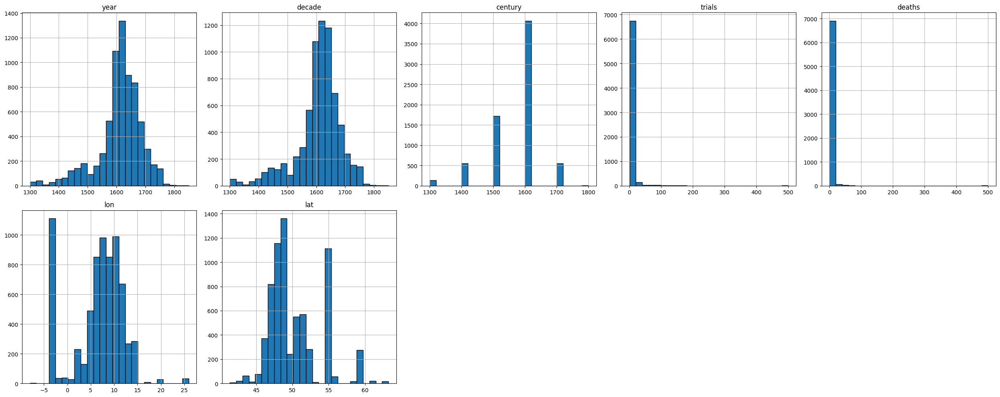

In [ ]:
# plots the histogram for each numerical feature in a separate subplot
witch.hist(bins=25, layout=(-1, 5), edgecolor="black", figsize=(25,10))
plt.tight_layout()
plt.show()

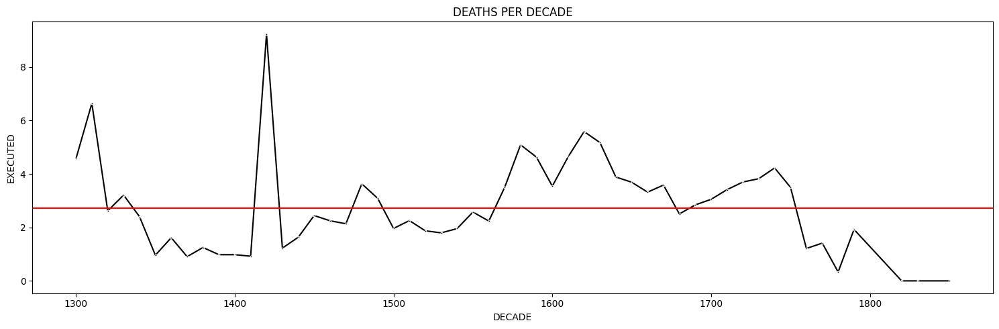

In [ ]:
# plot
plt.figure(figsize=(15,5))
ax = sns.lineplot(data=witch, y="deaths", x="decade", marker="o", markersize=2, color="black", errorbar=None)

# configuration
ax.ticklabel_format(style="plain", axis="y")
plt.axhline(2.72, color="red")
# plt.text(f"average deaths = {str(round(witch.deaths.mean(),2))}", fontsize=25, color="black")

# parameters
plt.title("DEATHS PER DECADE")
plt.xlabel("DECADE")
plt.ylabel("EXECUTED")
plt.tight_layout()
plt.show()

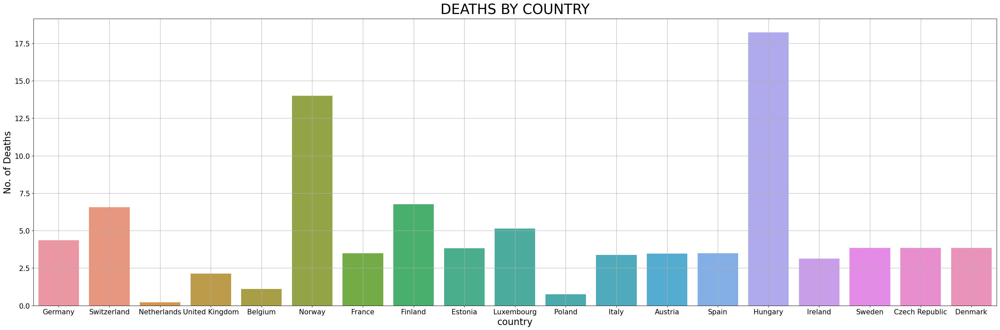

In [ ]:
deathsTrials = witch[["country", "trials", "deaths"]].sort_values(by="deaths", ascending=False).copy()

# plot
plt.figure(figsize=(30,10))
ax1 = sns.barplot(data=deathsTrials.sort_values(by="deaths", ascending=True), x="country", y="deaths", errorbar=None)
# ax2 = ax1.twinx()

# plotting
sns.lineplot(data=deathsTrials, x="country", y="trials", 
             marker="o", markeredgecolor="black", markersize=8,
             color="black", errorbar=None, ax=ax2)

# configuration ax1
ax1.ticklabel_format(style="plain", axis="y")
ax1.set(xlabel="country", ylabel="No. of Deaths")
ax1.set_xlabel("country", fontsize=20)
ax1.set_ylabel("No. of Deaths", fontsize=20)
ax1.tick_params(axis='x', labelsize=15)
ax1.tick_params(axis='y', labelsize=15)
ax1.grid(True)

# # configuration ax2
# ax2.set(ylabel="No. of Trials")
# ax2.set_ylabel("No. of Trials", fontsize=20)
# ax2.tick_params(axis='y', labelsize=15)
# ax2.grid(False)

# parameters
plt.title("DEATHS BY COUNTRY", fontsize=30, pad=10)
# plt.suptitle("header 2", y=0.9, fontsize=25, color="black")
plt.tight_layout()
plt.show()

### Interactive plots

In [ ]:
# Data
df_totals = pd.DataFrame(witch[['trials', 'deaths']].sum(),
                         columns=['people']).reset_index().sort_index()
df_totals['source'] = 'data'
df_totals.loc[2] = ['trials', 100000, 'estimation']
df_totals.loc[3] = ['deaths', 50000, 'estimation']
df_totals = df_totals.set_index(['source', 'index'])

x = df_totals.index.get_level_values(1).tolist()

# Sove set styling
titlefont = dict(family='Lucida Bright', size=20, color='#0f3a49')
titlefont_map = dict(family='Lucida Bright', size=20, color='#B2B297')
tickfont = dict(family='Lucida Bright', size=15, color='#0f3a49')
hoverlabel = dict(font=dict(family='Lucida Bright', size=15, color='#ffffff'))
bgcolor = '#D0D6D7'
gridcolor = '#E1E7E9'
zerolinecolor = '#E1E7E9'
legendfont = dict(family='Lucida Bright', size=15, color='#0f3a49')
legendfont_map = dict(family='Lucida Bright', size=15, color='#B2B297')

In [ ]:
# Data
witch_by_decade = witch[['decade', 'trials', 'deaths'
                           ]].groupby('decade').agg('sum').reset_index()
witch_by_decade['witch_mortality_rate'] = witch_by_decade[
    'deaths'] / witch_by_decade['trials']

# Figure
fig = make_subplots(specs=[[{"secondary_y": True}]])

fig.add_trace(go.Bar(x=witch_by_decade['decade'],
                     y=witch_by_decade['trials'],
                     width=9.9,
                     name='Trials',
                     marker={
                         'color': '#92361f',
                         'line_color': bgcolor,
                         'line_width': 0.1
                     },
                     hovertemplate='<extra></extra>%{x}s: %{y:,.0f}'),
              secondary_y=False)

fig.add_trace(go.Bar(x=witch_by_decade['decade'],
                     y=witch_by_decade['deaths'],
                     width=7,
                     name='Executed',
                     marker={
                         'color': '#040609',
                         'line_color': bgcolor,
                         'line_width': 0.1
                     },
                     hovertemplate='<extra></extra>%{x}s: %{y:,.0f}'),
              secondary_y=False)

fig.update_layout(title={
    'text': 'Witchcraft Trials and Deaths in Europe by Decade',
    'y': 0.97
},
                  title_y=0.88,
                  margin={
                      't': 140,
                      'b': 70,
                      'l': 70,
                      'r': 70
                  },
                  titlefont=titlefont,
                  plot_bgcolor=bgcolor,
                  paper_bgcolor=bgcolor,
                  barmode='overlay',
                  xaxis={
                      'title': None,
                      'tickfont': tickfont
                  },
                  yaxis={
                      'title': None,
                      'tickfont': tickfont,
                      'tickvals': [1000, 2000, 3000, 4000, 5000, 6000, 7000, 8000, 9000, 10000],
                      'tickformat': ',.0f',
                      'gridcolor': gridcolor,
                      'gridwidth': 0.1,
                      'zerolinecolor': zerolinecolor,
                      'showgrid': True
                  },
                  height=700,
                  width=1500,
                  legend={
                      'orientation': 'h',
                      'xanchor': 'right',
                      'yanchor': 'middle',
                      'x': 0.98,
                      'y': 1.2,
                      'font': legendfont,
                      'itemsizing': 'constant'
                  },
                  hoverlabel=hoverlabel)

fig.update_layout(
    xaxis=dict(
        title=dict(
            text='Decade',
            font=dict(
                size=15,
                color='#000000'
            )
        ),
        tickfont=dict(
            size=15,
            color='#000000'
        )
    ),
    legend=dict(
        font=dict(
            size=25,
            color='#000000'
        )
    )
)

fig.show()

In [ ]:
# Data
witch_by_country = witch[[
    'country', 'trials', 'deaths'
]].groupby('country').agg('sum').reset_index().sort_values(by='trials')
witch_by_country['witch_mortality_rate'] = witch_by_country['deaths'] / \
    witch_by_country['trials']
witch_by_country['max_trials'] = witch_by_country['trials'].max()

# Figure
fig = make_subplots(rows=1,
                    cols=2,
                    column_widths=[5, 2],
                    horizontal_spacing=0.03)

fig.add_trace(go.Bar(x=witch_by_country['trials'],
                     y=witch_by_country['country'],
                     width=0.98,
                     name='Trials',
                     orientation='h',
                     marker={
                         'color': '#92361f',
                         'line_color': bgcolor,
                         'line_width': 0.3
                     },
                     hovertemplate='<extra></extra>%{y}: %{x:,.0f}'),
              row=1,
              col=1)

fig.add_trace(go.Bar(x=witch_by_country['deaths'],
                     y=witch_by_country['country'],
                     width=0.75,
                     name='Executed',
                     orientation='h',
                     marker={
                         'color': '#040609',
                         'line_color': bgcolor,
                         'line_width': 0.3
                     },
                     hovertemplate='<extra></extra>%{y}: %{x:,.0f}'),
              row=1,
              col=1)

fig.add_trace(go.Bar(x=witch_by_country['witch_mortality_rate'],
                     y=witch_by_country['country'],
                     name='% Of trials Who Were deaths',
                     orientation='h',
                     width=0.9,
                     marker={
                         'color': witch_by_country['witch_mortality_rate'],
                         'colorscale': ['#0F3A49', '#92361F'],
                         'colorbar': None,
                         'cmin': 0,
                         'cmax': 1
                     },
                     hovertemplate='<extra></extra>%{y}: %{x}'),
              row=1,
              col=2)

fig['data'][2]['showlegend'] = False

fig.add_annotation(x=0.80,
                   y=1.13, 
                   xref='paper', 
                   yref='paper', 
                   text='% Of deaths:', 
                   showarrow=False, 
                   font=legendfont)

fig.update_layout(title={
    'text': 'People trials and deaths for witchcraft in Europe, by country',
    'y': 0.95
},
                  margin={
                      't': 140,
                      'b': 70,
                      'l': 70,
                      'r': 70, 
                      'pad': 3
                  },
                  titlefont=titlefont,
                  plot_bgcolor=bgcolor,
                  paper_bgcolor=bgcolor,
                  barmode='overlay',
                  xaxis={
                      'range': [0, 18000],
                      'title':
                      None,
                      'gridcolor':
                      gridcolor,
                      'zerolinecolor':
                      zerolinecolor,
                      'tickfont':
                      tickfont,
                      'tickvals':
                      [2000, 4000, 6000, 8000, 10000, 12000, 14000, 16000],
                      'tickformat':
                      ',.0f',
                      'showgrid':
                      True
                  },
                  yaxis={
                      'title': None,
                      'tickfont': tickfont
                  },
                  xaxis2={
                      'title': None,
                      'gridcolor': gridcolor,
                      'zerolinecolor': zerolinecolor,
                      'range': [0, 1.01],
                      'tickformat': ',.0%',
                      'tickvals': [0, 0.5, 1],
                      'tickfont': tickfont,
                      'showgrid': True
                  },
                  yaxis2={
                      'title': None,
                      'showticklabels': False
                  },
                  height=700,
                  width=1000,
                  legend={
                      'orientation': 'h',
                      'xanchor': 'right',
                      'yanchor': 'middle',
                      'x': 0.39,
                      'y': 1.11,
                      'font': legendfont,
                      'itemsizing': 'constant'
                  },
                  hoverlabel=hoverlabel)



fig.show()

In [ ]:
# Regional Data

treemap_df = witch.groupby(['country',
                             'region']).agg('sum')[['trials', 'deaths'
                                                        ]].reset_index()

# For structure to be mapped correctly, we need to count the witch which don't apply to any region
# (the 'undefined' regions) for each country:
aaa = treemap_df[['country', 'trials',
                  'deaths']].groupby('country').agg('sum')
bbb = witch[['country', 'trials', 'deaths']].groupby('country').agg('sum')
treemap_df_other = aaa.join(bbb, rsuffix='_all')
treemap_df_other[
    'trials_other'] = treemap_df_other['trials_all'] - treemap_df_other['trials']
treemap_df_other['deaths_other'] = treemap_df_other[
    'deaths_all'] - treemap_df_other['deaths']
treemap_df_other['region'] = 'Undefined Regions'
treemap_df_other = treemap_df_other.reset_index()[[
    'country', 'region', 'trials_other', 'deaths_other'
]].rename(columns={
    'trials_other': 'trials',
    'deaths_other': 'deaths'
})
treemap_df_other = treemap_df_other[treemap_df_other['trials'] > 0]
treemap_df = pd.concat([treemap_df, treemap_df_other], axis=0)

treemap_df['mortality rate'] = treemap_df['deaths'] / treemap_df[
    'trials']  # mortality in witch
# percentage of killed from all killed in Europe
treemap_df['perc_of_total'] = treemap_df['deaths'] / witch['deaths'].sum()

# City Data
treemap_df_city = witch.groupby(['country',
                                  'department']).agg('sum')[['trials', 'deaths'
                                                       ]].reset_index()

# Here we need 'undefigned' settlements:
aaa = treemap_df_city[['country', 'trials',
                       'deaths']].groupby('country').agg('sum')
bbb = witch[['country', 'trials', 'deaths']].groupby('country').agg('sum')
treemap_df_city_other = bbb.join(aaa, lsuffix='_all').fillna(0)
treemap_df_city_other['trials_other'] = treemap_df_city_other[
    'trials_all'] - treemap_df_city_other['trials']
treemap_df_city_other['deaths_other'] = treemap_df_city_other[
    'deaths_all'] - treemap_df_city_other['deaths']
treemap_df_city_other['city'] = 'Undefined Settlements'
treemap_df_city_other = treemap_df_city_other.reset_index()[[
    'country', 'city', 'trials_other', 'deaths_other'
]].rename(columns={
    'trials_other': 'trials',
    'deaths_other': 'deaths'
})
treemap_df_city_other = treemap_df_city_other[
    treemap_df_city_other['trials'] > 0]
treemap_df_city = pd.concat([treemap_df_city, treemap_df_city_other], axis=0)

treemap_df_city[
    'mortality rate'] = treemap_df_city['deaths'] / treemap_df_city['trials']
treemap_df_city[
    'perc_of_total'] = treemap_df_city['deaths'] / witch['deaths'].sum()

# Figure
def create_treemap(dataset, column, title):

    fig = px.treemap(dataset,
                     path=[px.Constant("Europe"), 'country', column],
                     values='trials',
                     color='mortality rate',
                     hover_data=['trials', 'deaths', 'perc_of_total'],
                     color_continuous_scale=["#0F3A49", "#92361F"],
                     custom_data=[
                         'country', column, 'trials', 'deaths',
                         'mortality rate', 'perc_of_total'
                     ])

    fig.update_layout(title={
        'text': title,
        'y': 0.92,
        'x': 0.1
    },
                      titlefont=titlefont,
                      margin={
                          't': 100,
                          'b': 70,
                          'l': 70,
                          'r': 70
                      },
                      height=500,
                      width=700,
                      font=legendfont,
                      plot_bgcolor=bgcolor,
                      paper_bgcolor=bgcolor,
                      coloraxis_colorbar={
                          'title': {
                              'text': '% Of deaths<br>&nbsp;',
                              'font': legendfont
                          },
                          'tickformat': ',.0%',
                          'tickfont': legendfont,
                          'thicknessmode': 'pixels',
                          'thickness': 15,
                          'lenmode': 'pixels',
                          'len': 300,
                          'ticks': 'outside'
                      },
                      hoverlabel=hoverlabel)

    # Totals for hoverlabels:
    fig.data[0].customdata[-1][0] = 'Total'
    fig.data[0].customdata[-1][1] = 'Europe'
    fig.data[0].customdata[-1][3] = dataset['deaths'].sum()
    fig.data[0].customdata[-1][5] = dataset['deaths'].sum(
    ) / dataset['deaths'].sum()

    country_list = dataset['country'].unique().tolist()

    for i in range(-20, -1):
        fig.data[0].customdata[i][0] = 'Total'
        fig.data[0].customdata[i][1] = country_list[i + 20]
        fig.data[0].customdata[i][3] = dataset[
            dataset['country'] == country_list[i + 20]]['deaths'].sum()
        fig.data[0].customdata[i][5] = dataset[
            dataset['country'] == country_list[
                i + 20]]['deaths'].sum() / dataset['deaths'].sum()

        fig.update_traces(
            hovertemplate='<b>%{customdata[1]}, %{customdata[0]}</b>\
            <br><br><b>    %{customdata[2]:,.0f}</b> people were trials\
            <br><br><b>    %{customdata[3]:,.0f}</b> people were deaths, which is:\
            <br><br><b>    %{customdata[4]:,.0%}</b> of all people trials in %{customdata[1]}\
            <br><b>    %{customdata[5]:,.0%}</b> of all people deaths in Europe<br>')

    fig.show()


create_treemap(treemap_df, 'region',
               'trials for witchcraft: regional structure')
print()
create_treemap(treemap_df_city, 'city', 'trials for witchcraft: city structure')

<ipython-input-249-9a7dad434d6a>:4: FutureWarning:

The default value of numeric_only in DataFrameGroupBy.sum is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.

<ipython-input-249-9a7dad434d6a>:34: FutureWarning:

The default value of numeric_only in DataFrameGroupBy.sum is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.



ValueError: ignored

### Folium

In [ ]:
m = folium.Map(location=[48.1351, 11.5820], zoom_start=5)

for index, row in witch.iterrows():
    radius = row["trials"]
    color = "red" if row["deaths"] > 0 else "blue"
    tooltip = folium.map.Tooltip(f"<i class='fas fa-info-circle'></i> {row['country']} ({row['decade']}0s): {row['trials']} trials, {row['deaths']} deaths", sticky=True)
    folium.CircleMarker(location=[row["lat"], row["lon"]], radius=radius, color=color, tooltip=tooltip, fill=True).add_to(m)

m

## Feature Engineering (*data augmentation*)

### Data preparation

Source for geojson data : [Eurostat](https://ec.europa.eu/eurostat/web/gisco/geodata/reference-data/administrative-units-statistical-units/nuts)

In [ ]:
trials = witch_backup.copy()
battles = pd.read_csv("/content/drive/MyDrive/[01] Data Analytics - IronHack/[06] Courses/Week 4/[Project 04] - Data Visualization/battles.csv")
battle_backup = battles.copy()

trials.rename(columns={"deaths": "executed"}, inplace=True)

with open("/content/drive/MyDrive/[01] Data Analytics - IronHack/[06] Courses/Week 4/[Project 04] - Data Visualization/NUTS_RG_20M_2021_4326.geojson", encoding="utf8") as geofile:
    jdataeu = json.load(geofile)

nuts = gpd.read_file("/content/drive/MyDrive/[01] Data Analytics - IronHack/[06] Courses/Week 4/[Project 04] - Data Visualization/NUTS_LB_2021_4326.geojson")

In [ ]:
# Fixing Data Types & Some Mistakes
trials = trials.rename(columns={'gadm.adm0': 'country', 'deaths': 'executed'})
trials['executed'] = trials['executed'].fillna(0)
trials['executed'] = trials['executed'].astype('int')
trials = trials.drop_duplicates()

# Today Valais is a Swiss territory, not French (both options are found in the dataset).
def fix_region_0(s):
    if s['gadm.adm1'] == 'Valais':
        return 'Switzerland'
    else:
        return s['country']

trials['country'] = trials.apply(fix_region_0, axis=1)

# "Appenzell" -> "Appenzell Ausserrhoden"
def fix_region_1(s):
    if s['gadm.adm1'] == 'Appenzell':
        return 'Appenzell Ausserrhoden'
    else:
        return s['gadm.adm1']

trials['gadm.adm1'] = trials.apply(fix_region_1, axis=1)

# Mark "Luxembourg" that is a region in Belgium, not the country, as Luxembourg (BE) for treemap.
def fix_region_2(s):
    if s['gadm.adm2'] == 'Luxembourg':
        return 'Luxembourg (BE)'
    else:
        return s['gadm.adm2']

trials['gadm.adm2'] = trials.apply(fix_region_2, axis=1)

battles = battles.replace(['England', 'Northern Ireland', 'Scotland', 'Wales'],
                          'United Kingdom')

In [ ]:
# Remapping & Adding New Columns

# A new column: regions that correspond to one of NUTS regional levels (NUTS-2 to for the majority
# of countries):

def new_region(s):
    # Denmark
    if s['gadm.adm1'] in ('Fyn', 'Ribe', 'South Jutland'):
        return 'Southern Denmark'
    elif s['gadm.adm1'] == 'Ringkobing':
        return 'Central Jutland'
    elif s['gadm.adm1'] == 'Storstrom':
        return 'Zealand'
    # Ireland
    elif s['gadm.adm1'] in ('Cork', 'Kilkenny', 'Clare', 'Wexford', 'Waterford', 'Tipperary', 'Limerick'):
        return 'Southern'
    elif s['gadm.adm1'] in ('Louth', 'Meath', 'Dublin'):
        return 'Eastern and Midland'
    elif s['gadm.adm1'] in ('Donegal', 'Galway'):
        return 'Northern and Western'
    # Germany
    elif s['gadm.adm2'] in ('Magdeburg', 'Dessau', 'Halle'):
        return 'Sachsen-Anhalt'
    # UK
    elif s['gadm.adm2'] in ('Hertfordshire', 'Bedfordshire'):
        return 'Bedfordshire and Hertfordshire'
    elif s['gadm.adm2'] in ('Oxfordshire', 'Buckinghamshire', 'Berkshire'):
        return 'Berkshire, Buckinghamshire and Oxfordshire'
    elif s['gadm.adm2'] == 'Cornwall':
        return 'Cornwall and Isles of Scilly'
    elif s['gadm.adm2'] in ('Nottingham', 'Derby', 'Derbyshire'):
        return 'Derbyshire and Nottinghamshire'
    elif s['gadm.adm2'] in ('Dorset', 'Somerset'):
        return 'Dorset and Somerset'
    elif s['gadm.adm2'] in ('Norfolk', 'Cambridgeshire', 'Suffolk'):
        return 'East Anglia'
    elif s['gadm.adm2'] == 'Cardiff':
        return 'East Wales'
    elif s['gadm.adm2'] == 'East Riding of Yorkshire':
        return 'East Yorkshire and Northern Lincolnshire'
    elif s['gadm.adm2'] in ('Fife', 'Stirling', 'Angus', 'Perthshire and Kinross', 'Edinburgh',
                            'East Lothian', 'West Lothian', 'Clackmannanshire', 'Dundee'):
        return 'Eastern Scotland'
    elif s['gadm.adm2'] in ('Wiltshire', 'Bristol', 'Gloucestershire'):
        return 'Gloucestershire, Wiltshire and Bristol/Bath area'
    elif s['gadm.adm2'] == 'Manchester':
        return 'Greater Manchester'
    elif s['gadm.adm2'] in ('Hampshire', 'Southampton'):
        return 'Hampshire and Isle of Wight'
    elif s['gadm.adm2'] in ('Worcestershire', 'Warwickshire'):
        return 'Herefordshire, Worcestershire and Warwickshire'
    elif s['gadm.adm2'] in ('Highland', 'Orkney Islands', 'Argyll and Bute', 'Shetland Islands', 'Moray'):
        return 'Highlands and Islands'
    elif s['gadm.adm2'] in ('Leicester', 'Rutland', 'Northamptonshire'):
        return 'Leicestershire, Rutland and Northamptonshire'
    elif s['gadm.adm2'] in ('Aberdeenshire', 'Aberdeen'):
        return 'North Eastern Scotland'
    elif s['gadm.adm2'] == 'York':
        return 'North Yorkshire'
    elif s['gadm.adm2'] in ('Newry and Mourne', 'Lisburn', 'Dungannon', 'Derry', 'Armagh', 'Antrim'):
        return 'Northern Ireland'
    elif s['gadm.adm2'] in ('Tyne and Wear', 'Northumberland'):
        return 'Northumberland and Tyne and Wear'
    elif s['gadm.adm2'] in ('Richmond upon Thames', 'Hounslow'):
        return 'Outer London — West and North West'
    elif s['gadm.adm2'] in ('Shropshire', 'Staffordshire'):
        return 'Shropshire and Staffordshire'
    elif s['gadm.adm2'] in ('Scottish Borders', 'South Ayrshire', 'Dumfries and Galloway',
                            'South Lanarkshire', 'East Ayrshire'):
        return 'Southern Scotland'
    elif s['gadm.adm2'] in ('East Sussex', 'West Sussex', 'Brighton and Hove'):
        return 'Surrey, East and West Sussex'
    elif s['gadm.adm2'] in ('Durham', 'Darlington'):
        return 'Tees Valley and Durham'
    elif s['gadm.adm2'] in ('West Dunbartonshire', 'Renfrewshire', 'North Lanarkshire'):
        return 'West Central Scotland'
    elif s['gadm.adm2'] in ('Carmarthenshire', 'Pembrokeshire'):
        return 'West Wales and The Valleys'
    # Portugal
    elif s['gadm.adm1'] == 'Faro':
        return 'Algarve'
    # Don't need to be corrected
    elif s['country'] in ('Austria', 'Czech Republic', 'France', 'Italy', 'Netherlands', 'Poland',
                          'Spain', 'Sweden', 'Switzerland'):
        return s['gadm.adm1']
    elif s['country'] in ('Belgium', 'Germany', 'United Kingdom'):
        return s['gadm.adm2']
    elif s['country'] in ('Luxembourg', 'Estonia', 'Finland', 'Hungary', 'Norway'):
        return s['country']

trials['new_region'] = trials.apply(new_region, axis=1)
battles['new_region'] = battles.apply(new_region, axis=1)

# A new column: corresponding NUTS codes (source: Eurostat):

new_id_dict = {
    'Niederosterreich': 'AT12',
    'Wien': 'AT13',
    'Steiermark': 'AT22',
    'Oberosterreich': 'AT31',
    'Salzburg': 'AT32',
    'Tirol': 'AT33',
    'Vorarlberg': 'AT34',
    'Namur': 'BE35',
    'Liege': 'BE33',
    'Hainaut': 'BE32',
    'Brabant Wallon': 'BE31',
    'Luxembourg (BE)': 'BE34',
    'Bruxelles': 'BE10',
    'West-Vlaanderen': 'BE25',
    'Oost-Vlaanderen': 'BE23',
    'Vlaams Brabant': 'BE24',
    'Antwerpen': 'BE21',
    'Plzensky': 'CZ032',
    'Jihocesky': 'CZ031',
    'Prague': 'CZ010',
    'Jihomoravsky': 'CZ064',
    'Stredocesky': 'CZ020',
    'Olomoucky': 'CZ071',
    'Alsace': 'FRF1',
    'Aquitaine': 'FRI1',
    'Auvergne': 'FRK1',
    'Basse-Normandie': 'FRD1',
    'Bourgogne': 'FRC1',
    'Bretagne': 'FRH0',
    'Centre': 'FRB0',
    'Champagne-Ardenne': 'FRF2',
    'Franche-Comte': 'FRC2',
    'Haute-Normandie': 'FRD2',
    'Ile-de-France': 'FR10',
    'Languedoc-Roussillon': 'FRJ1',
    'Limousin': 'FRI2',
    'Lorraine': 'FRF3',
    'Midi-Pyrenees': 'FRJ2',
    'Nord-Pas-de-Calais': 'FRE1',
    'Pays de la Loire': 'FRG0',
    'Picardie': 'FRE2',
    'Poitou-Charentes': 'FRI3',
    "Provence-Alpes-Cote d'Azur": 'FRL0',
    'Rhone-Alpes': 'FRK2',
    'Stuttgart': 'DE11',
    'Karlsruhe': 'DE12',
    'Freiburg': 'DE13',
    'Tubingen': 'DE14',
    'Oberbayern': 'DE21',
    'Niederbayern': 'DE22',
    'Oberpfalz': 'DE23',
    'Oberfranken': 'DE24',
    'Mittelfranken': 'DE25',
    'Unterfranken': 'DE26',
    'Schwaben': 'DE27',
    'Berlin': 'DE30',
    'Brandenburg': 'DE40',
    'Hamburg': 'DE60',
    'Darmstadt': 'DE71',
    'Giessen': 'DE72',
    'Kassel': 'DE73',
    'Mecklenburg-Vorpommern': 'DE80',
    'Braunschweig': 'DE91',
    'Hannover': 'DE92',
    'Luneburg': 'DE93',
    'Weser-Ems': 'DE94',
    'Dusseldorf': 'DEA1',
    'Koln': 'DEA2',
    'Munster': 'DEA3',
    'Detmold': 'DEA4',
    'Arnsberg': 'DEA5',
    'Koblenz': 'DEB1',
    'Trier': 'DEB2',
    'Rheinhessen-Pfalz': 'DEB3',
    'Saarland': 'DEC0',
    'Dresden': 'DED2',
    'Chemnitz': 'DED4',
    'Leipzig': 'DED5',
    'Sachsen-Anhalt': 'DEE0',
    'Schleswig-Holstein': 'DEF0',
    'Thuringen': 'DEG0',
    'Piemonte': 'ITC1',
    'Lombardia': 'ITC4',
    'Trentino-Alto Adige': 'ITH2',
    'Veneto': 'ITH3',
    'Emilia-Romagna': 'ITH5',
    'Toscana': 'ITI1',
    'Umbria': 'ITI2',
    'Marche': 'ITI3',
    'Lazio': 'ITI4',
    'Luxembourg': 'LU00',
    'Groningen': 'NL11',
    'Friesland': 'NL12',
    'Overijssel': 'NL21',
    'Gelderland': 'NL22',
    'Flevoland': 'NL23',
    'Utrecht': 'NL31',
    'Noord-Holland': 'NL32',
    'Zuid-Holland': 'NL33',
    'Zeeland': 'NL34',
    'Noord-Brabant': 'NL41',
    'Limburg': 'NL42',
    'Greater Poland': 'PL41',
    'Lower Silesian': 'PL51',
    'Warmian-Masurian': 'PL62',
    'Pais Vasco': 'ES21',
    'Comunidad Foral de Navarra': 'ES22',
    'Castilla y Leon': 'ES41',
    'Cataluna': 'ES51',
    'Andalucia': 'ES61',
    'Ostergotland': 'SE123',
    'Jonkoping': 'SE211',
    'Kronoberg': 'SE212',
    'Kalmar': 'SE213',
    'Blekinge': 'SE221',
    'Skane': 'SE224',
    'Halland': 'SE231',
    'Vastra Gotaland': 'SE232',
    'Varmland': 'SE311',
    'Vaud': 'CH011',
    'Valais': 'CH012',
    'Geneve': 'CH013',
    'Bern': 'CH021',
    'Fribourg': 'CH022',
    'Solothurn': 'CH023',
    'Neuchatel': 'CH024',
    'Basel-Stadt': 'CH031',
    'Basel-Landschaft': 'CH032',
    'Aargau': 'CH033',
    'Zurich': 'CH040',
    'Glarus': 'CH051',
    'Schaffhausen': 'CH052',
    'Appenzell Ausserrhoden': 'CH053',
    'Appenzell Innerrhoden': 'CH054',
    'Sankt Gallen': 'CH055',
    'Graubunden': 'CH056',
    'Thurgau': 'CH057',
    'Lucerne': 'CH061',
    'Uri': 'CH062',
    'Schwyz': 'CH063',
    'Obwalden': 'CH064',
    'Nidwalden': 'CH065',
    'Ticino': 'CH070',
    'Zug': 'CH066',
    'Tees Valley and Durham': 'UKC1',
    'Northumberland and Tyne and Wear': 'UKC2',
    'Cumbria': 'UKD1',
    'Greater Manchester': 'UKD3',
    'Lancashire': 'UKD4',
    'Cheshire': 'UKD6',
    'East Yorkshire and Northern Lincolnshire': 'UKE1',
    'North Yorkshire': 'UKE2',
    'West Yorkshire': 'UKE4',
    'Derbyshire and Nottinghamshire': 'UKF1',
    'Leicestershire, Rutland and Northamptonshire': 'UKF2',
    'Lincolnshire': 'UKF3',
    'Herefordshire, Worcestershire and Warwickshire': 'UKG1',
    'Shropshire and Staffordshire': 'UKG2',
    'West Midlands': 'UKG3',
    'East Anglia': 'UKH1',
    'Bedfordshire and Hertfordshire': 'UKH2',
    'Essex': 'UKH3',
    'Outer London — West and North West': 'UKI7',
    'Berkshire, Buckinghamshire and Oxfordshire': 'UKJ1',
    'Surrey, East and West Sussex': 'UKJ2',
    'Hampshire and Isle of Wight': 'UKJ3',
    'Kent': 'UKJ4',
    'Gloucestershire, Wiltshire and Bristol/Bath area': 'UKK1',
    'Dorset and Somerset': 'UKK2',
    'Cornwall and Isles of Scilly': 'UKK3',
    'Devon': 'UKK4',
    'West Wales and The Valleys': 'UKL1',
    'East Wales': 'UKL2',
    'North Eastern Scotland': 'UKM5',
    'Highlands and Islands': 'UKM6',
    'Eastern Scotland': 'UKM7',
    'West Central Scotland': 'UKM8',
    'Southern Scotland': 'UKM9',
    'Northern Ireland': 'UKN0',
    'Estonia': 'EE00',
    'Finland': 'FI1',
    'Hungary': 'HU',
    'Norway': 'NO0',
    'Zealand': 'DK02',
    'Southern Denmark': 'DK03',
    'Central Jutland': 'DK04',
    'Northern and Western': 'IE04',
    'Southern': 'IE05',
    'Eastern and Midland': 'IE06',
    'Algarve': 'PT15'
}

trials['map_id'] = trials['new_region'].map(new_id_dict)
battles['map_id'] = battles['new_region'].map(new_id_dict)

# A new column: NUTS level used for the country (2-digit code = country (0); 3-digit = 1st,
# 4-digit = 2nd, 5-digit = 3rd):

def set_nuts(s):
    if len(str(s['map_id'])) == 5:
        return 3
    elif len(str(s['map_id'])) == 4:
        return 2
    elif len(str(s['map_id'])) == 3 and str(s['map_id']) != 'nan':
        return 1
    elif len(str(s['map_id'])) == 2:
        return 0
    else:
        return s['map_id']

trials['nuts_level'] = trials.apply(set_nuts, axis=1)
battles['nuts_level'] = battles.apply(set_nuts, axis=1)

# A new column: country code:
trials['cntr_code'] = trials['map_id'].str[:2]
battles['cntr_code'] = battles['map_id'].str[:2]

# A new column to count totals in a treemap: for the countries with no regional detalisation,
# regions are 'undefigned':

def region_map(s):
    if s['country'] in ('Austria', 'Belgium', 'Czech Republic', 'Denmark', 'Germany', 'France', 
                        'Netherlands', 'Sweden', 'Switzerland', 'United Kingdom', 'Italy', 'Poland',
                        'Spain', 'Portugal'):
        return s['new_region']
    elif s['country'] in ('Estonia', 'Finland', 'Hungary', 'Ireland', 'Luxembourg', 'Norway'):
        return 'Undefined Regions'
    else:
        return np.nan

trials['region_map'] = trials.apply(region_map, axis=1)

print(
    'New regional division by NUTS (0 = country; 1-3 = corresponding NUTS levels):'
)
trials[['country', 'nuts_level']].dropna().drop_duplicates().sort_values(
    by='nuts_level').reset_index(drop=True)

New regional division by NUTS (0 = country; 1-3 = corresponding NUTS levels):


,country,nuts_level
0,Hungary,0.00
1,Finland,1.00
2,Norway,1.00
3,Estonia,2.00
4,Poland,2.00
5,Italy,2.00
6,Netherlands,2.00
7,Spain,2.00
8,Luxembourg,2.00
9,United Kingdom,2.00


In [ ]:
# Counting nulls after remapping

value_nulls = dict()
value_nulls['Country'] = []
value_nulls['Total_Rows'] = []

# NaNs when filter by the largest regional column from the initial data:
value_nulls['NaN_OLD_region'] = []
# NaNs when filter by the new column:
value_nulls['NaN_NEW_region'] = []

for n in trials['country'].unique():
    value_nulls['Country'].append(n)
    value_nulls['Total_Rows'].append(
        trials[trials['country'] == n]['map_id'].count())
    value_nulls['NaN_OLD_region'].append(trials[
        trials['country'] == n]['gadm.adm1'].isnull().values.ravel().sum())
    value_nulls['NaN_NEW_region'].append(
        trials[trials['country'] == n]['map_id'].isnull().values.ravel().sum())

value_nulls = pd.DataFrame(value_nulls)
value_nulls['NaN_OLD_region_%'] = (value_nulls['NaN_OLD_region'] /
                                   value_nulls['Total_Rows'] * 100).round(1)
value_nulls['NaN_NEW_region_%'] = (value_nulls['NaN_NEW_region'] /
                                   value_nulls['Total_Rows'] * 100).round(1)

print('How much data is lost after remapping?')
value_nulls

How much data is lost after remapping?


,Country,Total_Rows,NaN_OLD_region,NaN_NEW_region,NaN_OLD_region_%,NaN_NEW_region_%
0,Estonia,17,17,0,100.00,0.00
1,Finland,17,17,0,100.00,0.00
2,Hungary,26,26,0,100.00,0.00
3,Norway,20,20,0,100.00,0.00
4,Switzerland,862,6,6,0.70,0.70
5,Germany,2904,4,59,0.10,2.00
6,Austria,12,4,4,33.30,33.30
7,France,614,51,51,8.30,8.30
8,Belgium,494,0,0,0.00,0.00
9,Ireland,4,0,0,0.00,0.00


### Charts

In [ ]:
# Data
df_totals = pd.DataFrame(trials[['tried', 'executed']].sum(),
                         columns=['people']).reset_index().sort_index()
df_totals['source'] = 'data'
df_totals.loc[2] = ['tried', 100000, 'estimation']
df_totals.loc[3] = ['executed', 50000, 'estimation']
df_totals = df_totals.set_index(['source', 'index'])

x = df_totals.index.get_level_values(1).tolist()

# Sove set styling
titlefont = dict(family='Lucida Bright', size=20, color='#0f3a49')
titlefont_map = dict(family='Lucida Bright', size=20, color='#B2B297')
tickfont = dict(family='Lucida Bright', size=10, color='#0f3a49')
hoverlabel = dict(font=dict(family='Lucida Bright', size=12, color='#ffffff'))
bgcolor = '#D0D6D7'
gridcolor = '#E1E7E9'
zerolinecolor = '#E1E7E9'
legendfont = dict(family='Lucida Bright', size=10, color='#0f3a49')
legendfont_map = dict(family='Lucida Bright', size=10, color='#B2B297')

#### Years of witch trial activity

##### code

In [ ]:
# Data

trials_by_decade = trials[['decade', 'tried', 'executed'
                           ]].groupby('decade').agg('sum').reset_index()
trials_by_decade['trials_mortality_rate'] = trials_by_decade[
    'executed'] / trials_by_decade['tried']

# Figure

fig = make_subplots(specs=[[{"secondary_y": True}]])

fig.add_trace(go.Bar(x=trials_by_decade['decade'],
                     y=trials_by_decade['tried'],
                     width=9.9,
                     name='People Tried',
                     marker={
                         'color': '#92361f',
                         'line_color': bgcolor,
                         'line_width': 0.1
                     },
                     hovertemplate='<extra></extra>%{x}s: %{y:,.0f}'),
              secondary_y=False)

fig.add_trace(go.Bar(x=trials_by_decade['decade'],
                     y=trials_by_decade['executed'],
                     width=7,
                     name='People Executed',
                     marker={
                         'color': '#040609',
                         'line_color': bgcolor,
                         'line_width': 0.1
                     },
                     hovertemplate='<extra></extra>%{x}s: %{y:,.0f}'),
              secondary_y=False)

fig.add_trace(go.Scatter(x=trials_by_decade['decade'],
                         y=trials_by_decade['trials_mortality_rate'],
                         name='% Of Executed ',
                         mode='lines',
                         marker_color='#60737A',
                         line_width=1.5,
                         line_dash='dot',
                         hovertemplate='<extra></extra>%{x}s: %{y}'),
              secondary_y=True)

fig.update_layout(title={
    'text': 'People tried and executed for witchcraft in Europe, by decade',
    'y': 0.97
},
                  title_y=0.88,
                  margin={
                      't': 140,
                      'b': 70,
                      'l': 70,
                      'r': 70
                  },
                  titlefont=titlefont,
                  plot_bgcolor=bgcolor,
                  paper_bgcolor=bgcolor,
                  barmode='overlay',
                  xaxis={
                      'title': None,
                      'tickfont': tickfont
                  },
                  yaxis={
                      'title': None,
                      'tickfont': tickfont,
                      'tickvals': [1000, 2000, 3000, 4000, 5000, 6000],
                      'tickformat': ',.0f',
                      'gridcolor': gridcolor,
                      'gridwidth': 0.1,
                      'zerolinecolor': zerolinecolor,
                      'showgrid': True
                  },
                  yaxis2={
                      'range': [0, 0.9],
                      'title': None,
                      'tickfont': tickfont,
                      'tickvals': [0.15, 0.3, 0.45, 0.6, 0.75, 0.9],
                      'tickformat': ',.0%',
                      'zerolinecolor': zerolinecolor,
                      'showgrid': False
                  },
                  height=400,
                  width=720,
                  legend={
                      'orientation': 'h',
                      'xanchor': 'right',
                      'yanchor': 'middle',
                      'x': 0.98,
                      'y': 1.2,
                      'font': legendfont,
                      'itemsizing': 'constant'
                  },
                  hoverlabel=hoverlabel)

##### plot

In [ ]:
fig.show()

#### Europe's deadliest countries

##### code

In [ ]:
# Data

trials_by_country = trials[[
    'country', 'tried', 'executed'
]].groupby('country').agg('sum').reset_index().sort_values(by='tried')
trials_by_country['trials_mortality_rate'] = trials_by_country['executed'] / \
    trials_by_country['tried']
trials_by_country['max_tried'] = trials_by_country['tried'].max()

# Figure

fig = make_subplots(rows=1,
                    cols=2,
                    column_widths=[0.8, 0.2],
                    horizontal_spacing=0.03)

fig.add_trace(go.Bar(x=trials_by_country['tried'],
                     y=trials_by_country['country'],
                     width=0.98,
                     name='People Tried',
                     orientation='h',
                     marker={
                         'color': '#92361f',
                         'line_color': bgcolor,
                         'line_width': 0.3
                     },
                     hovertemplate='<extra></extra>%{y}: %{x:,.0f}'),
              row=1,
              col=1)

fig.add_trace(go.Bar(x=trials_by_country['executed'],
                     y=trials_by_country['country'],
                     width=0.75,
                     name='People Executed',
                     orientation='h',
                     marker={
                         'color': '#040609',
                         'line_color': bgcolor,
                         'line_width': 0.3
                     },
                     hovertemplate='<extra></extra>%{y}: %{x:,.0f}'),
              row=1,
              col=1)

fig.add_trace(go.Bar(x=trials_by_country['trials_mortality_rate'],
                     y=trials_by_country['country'],
                     name='% Of Tried Who Were Executed',
                     orientation='h',
                     width=0.9,
                     marker={
                         'color': trials_by_country['trials_mortality_rate'],
                         'colorscale': ['#0F3A49', '#92361F'],
                         'colorbar': None,
                         'cmin': 0,
                         'cmax': 1
                     },
                     hovertemplate='<extra></extra>%{y}: %{x}'),
              row=1,
              col=2)

fig['data'][2]['showlegend'] = False

fig.add_annotation(x=0.97,
                   y=1.13, 
                   xref='paper', 
                   yref='paper', 
                   text='% Of Executed:', 
                   showarrow=False, 
                   font=legendfont)

fig.update_layout(title={
    'text': 'People tried and executed for witchcraft in Europe, by country',
    'y': 0.9
},
                  margin={
                      't': 140,
                      'b': 70,
                      'l': 70,
                      'r': 70, 
                      'pad': 3
                  },
                  titlefont=titlefont,
                  plot_bgcolor=bgcolor,
                  paper_bgcolor=bgcolor,
                  barmode='overlay',
                  xaxis={
                      'range': [0, 18000],
                      'title':
                      None,
                      'gridcolor':
                      gridcolor,
                      'zerolinecolor':
                      zerolinecolor,
                      'tickfont':
                      tickfont,
                      'tickvals':
                      [2000, 4000, 6000, 8000, 10000, 12000, 14000, 16000],
                      'tickformat':
                      ',.0f',
                      'showgrid':
                      True
                  },
                  yaxis={
                      'title': None,
                      'tickfont': tickfont
                  },
                  xaxis2={
                      'title': None,
                      'gridcolor': gridcolor,
                      'zerolinecolor': zerolinecolor,
                      'range': [0, 1.01],
                      'tickformat': ',.0%',
                      'tickvals': [0, 0.5, 1],
                      'tickfont': tickfont,
                      'showgrid': True
                  },
                  yaxis2={
                      'title': None,
                      'showticklabels': False
                  },
                  height=530,
                  width=720,
                  legend={
                      'orientation': 'h',
                      'xanchor': 'right',
                      'yanchor': 'middle',
                      'x': 0.39,
                      'y': 1.11,
                      'font': legendfont,
                      'itemsizing': 'constant'
                  },
                  hoverlabel=hoverlabel)

##### plot

In [ ]:
fig.show()

#### The lifespan and scope of the witch hunt across countries

##### code

In [ ]:
# Data

trials_by_decade_and_country = trials[[
    'country', 'decade', 'tried', 'executed'
]].groupby(['country', 'decade']).agg('sum').reset_index()

# to build the subplots, we need all the decades between 1300 and 1850 for each country:

a = np.arange(1300, 1860, 10)
b = trials['country'].sort_values().unique()
c = 0

index_df = pd.melt(
    pd.DataFrame(data=c, index=a,
                 columns=b).reset_index().rename(columns={'index': 'decade'}),
    id_vars='decade',
    var_name='country')

# columns to order the subplots: 1) the decade of the first trial; 
# 2) maximum number of people tried during the decade:

trials_by_decade_and_country[
    'min_decade'] = trials_by_decade_and_country.groupby(
        'country')['decade'].transform('min')
trials_by_decade_and_country[
    'max_tried'] = trials_by_decade_and_country.groupby(
        'country')['tried'].transform('max')

# joining everything

trials_by_decade_and_country = index_df.drop('value', axis=1).set_index([
    'decade', 'country'
]).join(trials_by_decade_and_country[[
    'tried', 'executed', 'decade', 'country'
]].set_index(['decade', 'country']),
        how='left').reset_index().set_index('country').join(
            trials_by_decade_and_country[[
                'min_decade', 'max_tried', 'country'
            ]].drop_duplicates().set_index('country'),
            how='left').sort_values(by=['min_decade', 'max_tried'],
                                    ascending=[True, False])

trials_by_decade_and_country['trials_mortality_rate'] = trials_by_decade_and_country['executed'] / \
    trials_by_decade_and_country['tried']

x = trials_by_decade_and_country['decade'].unique().tolist()  # x-axes
titles = trials_by_decade_and_country.index.unique().tolist()  # subplot names

# y-axes:
y_tried = []
y_executed = []
y_mortality = []

for country in trials_by_decade_and_country.index.unique():
    y_tried.append(trials_by_decade_and_country.loc[country]['tried'])
    y_executed.append(trials_by_decade_and_country.loc[country]['executed'])
    y_mortality.append(
        trials_by_decade_and_country.loc[country]['trials_mortality_rate'])

# Figure

fig = make_subplots(19,
                    1,
                    specs=[[{
                        "secondary_y": True
                    }]] * 19,
                    subplot_titles=titles,
                    vertical_spacing=0.025)

for i in range(1, 20):
    fig.add_trace(
        go.Bar(x=x,
               y=y_tried[i - 1],
               width=9,
               name='People Tried',
               marker={
                   'color': '#92361f',
                   'line_color': bgcolor,
                   'line_width': 0.3
               },
               hoverinfo='none',
               customdata=np.stack(
                   (x, y_tried[i - 1], y_executed[i - 1], y_mortality[i - 1]),
                   axis=-1),
               hovertemplate='<extra></extra>Decade: %{customdata[0]}s\
            <br>Tried: %{customdata[1]}<br>Executed: %{customdata[2]}<br>Trial Mortality: %{customdata[3]:,.0%}'
               ),
        secondary_y=False,
        row=i,
        col=1)

    fig.add_trace(
        go.Bar(x=x,
               y=y_executed[i - 1],
               width=6.5,
               name='People Executed',
               marker={
                   'color': '#040609',
                   'line_color': bgcolor,
                   'line_width': 0.3
               },
               hoverinfo='none',
               customdata=np.stack(
                   (x, y_tried[i - 1], y_executed[i - 1], y_mortality[i - 1]),
                   axis=-1),
               hovertemplate='<extra></extra>Decade: %{customdata[0]}s\
            <br>Tried: %{customdata[1]}<br>Executed: %{customdata[2]}<br>Trial Mortality: %{customdata[3]:,.0%}'
               ),
        secondary_y=False,
        row=i,
        col=1)

    fig.add_trace(go.Scatter(
        x=x,
        y=y_mortality[i - 1],
        name='% Of Executed',
        mode='lines',
        marker_color='#60737A',
        line_width=1.5,
        line_dash='dot',
        customdata=np.stack(
            (x, y_tried[i - 1], y_executed[i - 1], y_mortality[i - 1]),
            axis=-1),
        hovertemplate='<extra></extra>Decade: %{customdata[0]}s\
            <br>Tried: %{customdata[1]}<br>Executed: %{customdata[2]}<br>Trial Mortality: %{customdata[3]:,.0%}'
    ),
                  secondary_y=True,
                  row=i,
                  col=1)

fig.update_xaxes(title=None, tickfont=tickfont)

# Arranging dual y-axis:
main_axes_dict = dict(title=None,
                      range=[0, 2500],
                      tickvals=[1000, 2000],
                      tickfont=tickfont,
                      tickformat=',.0f',
                      zeroline=True,
                      zerolinewidth=0.1,
                      gridcolor=gridcolor,
                      zerolinecolor=zerolinecolor)

secondary_axes_dict = dict(title=None,
                           range=[0, 1.25],
                           tickfont=tickfont,
                           tickvals=[0.5, 1],
                           tickformat=',.0%',
                           showgrid=False,
                           zeroline=False)

fig['layout']['yaxis'].update(main_axes_dict)

for i in range(3, 38, 2):
    fig['layout'][f'yaxis{i}'].update(main_axes_dict)

for i in range(2, 39, 2):
    fig['layout'][f'yaxis{i}'].update(secondary_axes_dict)

# Show legend items for only the first three traces:
for i in range(0, 57):
    if i < 3:
        fig['data'][i]['showlegend'] = True
    else:
        fig['data'][i]['showlegend'] = False

fig.update_layout(title={
    'text':
    'Number of people tried and executed for witchcraft<br>from 1300 to 1850, by country',
    'y': 0.98
},
                  autosize=True,
                  margin={
                      't': 170,
                      'b': 70,
                      'l': 70,
                      'r': 50,
                      'pad': 3
                  },
                  titlefont=titlefont,
                  plot_bgcolor=bgcolor,
                  paper_bgcolor=bgcolor,
                  barmode='overlay',
                  width=720,
                  height=2900,
                  legend={
                      'orientation': 'h',
                      'xanchor': 'right',
                      'yanchor': 'middle',
                      'x': 1,
                      'y': 1.016,
                      'font': legendfont,
                      'itemsizing': 'constant'
                  },
                  hoverlabel=hoverlabel)

fig.update_annotations(font={
    'family': 'Lucida Bright',
    'size': 13,
    'color': '#92361f'
},
                       xanchor='left',
                       x=0)

##### plot

In [ ]:
fig.show()

#### Witch-hunting regions and cities of Europe

##### code

In [ ]:
# Regional Data

treemap_df = trials.groupby(['country',
                             'region_map']).agg('sum')[['tried', 'executed'
                                                        ]].reset_index()

# For structure to be mapped correctly, we need to count the trials which don't apply to any region
# (the 'undefined' regions) for each country:

aaa = treemap_df[['country', 'tried',
                  'executed']].groupby('country').agg('sum')
bbb = trials[['country', 'tried', 'executed']].groupby('country').agg('sum')
treemap_df_other = aaa.join(bbb, rsuffix='_all')
treemap_df_other[
    'tried_other'] = treemap_df_other['tried_all'] - treemap_df_other['tried']
treemap_df_other['executed_other'] = treemap_df_other[
    'executed_all'] - treemap_df_other['executed']
treemap_df_other['region_map'] = 'Undefined Regions'
treemap_df_other = treemap_df_other.reset_index()[[
    'country', 'region_map', 'tried_other', 'executed_other'
]].rename(columns={
    'tried_other': 'tried',
    'executed_other': 'executed'
})
treemap_df_other = treemap_df_other[treemap_df_other['tried'] > 0]
treemap_df = pd.concat([treemap_df, treemap_df_other], axis=0)

treemap_df['mortality rate'] = treemap_df['executed'] / treemap_df[
    'tried']  # mortality in trials
# percentage of killed from all killed in Europe
treemap_df['perc_of_total'] = treemap_df['executed'] / trials['executed'].sum()

# City Data

treemap_df_city = trials.groupby(['country',
                                  'city']).agg('sum')[['tried', 'executed'
                                                       ]].reset_index()

# Here we need 'undefigned' settlements:

aaa = treemap_df_city[['country', 'tried',
                       'executed']].groupby('country').agg('sum')
bbb = trials[['country', 'tried', 'executed']].groupby('country').agg('sum')
treemap_df_city_other = bbb.join(aaa, lsuffix='_all').fillna(0)
treemap_df_city_other['tried_other'] = treemap_df_city_other[
    'tried_all'] - treemap_df_city_other['tried']
treemap_df_city_other['executed_other'] = treemap_df_city_other[
    'executed_all'] - treemap_df_city_other['executed']
treemap_df_city_other['city'] = 'Undefined Settlements'
treemap_df_city_other = treemap_df_city_other.reset_index()[[
    'country', 'city', 'tried_other', 'executed_other'
]].rename(columns={
    'tried_other': 'tried',
    'executed_other': 'executed'
})
treemap_df_city_other = treemap_df_city_other[
    treemap_df_city_other['tried'] > 0]
treemap_df_city = pd.concat([treemap_df_city, treemap_df_city_other], axis=0)

treemap_df_city[
    'mortality rate'] = treemap_df_city['executed'] / treemap_df_city['tried']
treemap_df_city[
    'perc_of_total'] = treemap_df_city['executed'] / trials['executed'].sum()

# Figure


def create_treemap(dataset, column, title):

    fig = px.treemap(dataset,
                     path=[px.Constant("Europe"), 'country', column],
                     values='tried',
                     color='mortality rate',
                     hover_data=['tried', 'executed', 'perc_of_total'],
                     color_continuous_scale=["#0F3A49", "#92361F"],
                     custom_data=[
                         'country', column, 'tried', 'executed',
                         'mortality rate', 'perc_of_total'
                     ])

    fig.update_layout(title={
        'text': title,
        'y': 0.91
    },
                      titlefont=titlefont,
                      margin={
                          't': 100,
                          'b': 70,
                          'l': 70,
                          'r': 70
                      },
                      height=500,
                      width=720,
                      font=legendfont,
                      plot_bgcolor=bgcolor,
                      paper_bgcolor=bgcolor,
                      coloraxis_colorbar={
                          'title': {
                              'text': '% Of Executed<br>&nbsp;',
                              'font': legendfont
                          },
                          'tickformat': ',.0%',
                          'tickfont': legendfont,
                          'thicknessmode': 'pixels',
                          'thickness': 15,
                          'lenmode': 'pixels',
                          'len': 300,
                          'ticks': 'outside'
                      },
                      hoverlabel=hoverlabel)

    # Totals for hoverlabels:
    fig.data[0].customdata[-1][0] = 'Total'
    fig.data[0].customdata[-1][1] = 'Europe'
    fig.data[0].customdata[-1][3] = dataset['executed'].sum()
    fig.data[0].customdata[-1][5] = dataset['executed'].sum(
    ) / dataset['executed'].sum()

    country_list = dataset['country'].unique().tolist()

    for i in range(-20, -1):
        fig.data[0].customdata[i][0] = 'Total'
        fig.data[0].customdata[i][1] = country_list[i + 20]
        fig.data[0].customdata[i][3] = dataset[
            dataset['country'] == country_list[i + 20]]['executed'].sum()
        fig.data[0].customdata[i][5] = dataset[
            dataset['country'] == country_list[
                i + 20]]['executed'].sum() / dataset['executed'].sum()

        fig.update_traces(
            hovertemplate='<b>%{customdata[1]}, %{customdata[0]}</b>\
            <br><br><b>    %{customdata[2]:,.0f}</b> people were tried\
            <br><br><b>    %{customdata[3]:,.0f}</b> people were executed, which is:\
            <br><br><b>    %{customdata[4]:,.0%}</b> of all people tried in %{customdata[1]}\
            <br><b>    %{customdata[5]:,.0%}</b> of all people executed in Europe<br>')

<ipython-input-377-690eb4c325ea>:4: FutureWarning:

The default value of numeric_only in DataFrameGroupBy.sum is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.

<ipython-input-377-690eb4c325ea>:36: FutureWarning:

The default value of numeric_only in DataFrameGroupBy.sum is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.



##### plot

In [ ]:
    fig.show()


create_treemap(treemap_df, 'region_map',
               'Tried for witchcraft: regional structure')
print()
create_treemap(treemap_df_city, 'city', 'Tried for witchcraft: city structure')

#### Mapping the trials

##### code

In [ ]:
# Data

# trials

nuts_dict = trials.set_index('cntr_code')['nuts_level'].dropna().to_dict()
nuts_dict.update(
    battles.set_index('cntr_code')['nuts_level'].dropna().to_dict())

df_map = trials[['map_id', 'decade', 'tried',
                 'executed']].groupby('map_id').agg('sum').reset_index()
nuts_dict = trials.set_index('cntr_code')['nuts_level'].dropna().to_dict()
df_to_map = nuts.set_index('id').join(df_map.set_index('map_id')).reset_index()

df_to_map['tried'] = df_to_map['tried'].fillna(0)
df_to_map['executed'] = df_to_map['executed'].fillna(0)
df_to_map['trial mortality'] = df_to_map['executed'] / df_to_map['tried']
df_to_map['nuts_lvl'] = df_to_map['CNTR_CODE'].map(nuts_dict).fillna(0).astype(
    'int')

df_to_map = df_to_map[df_to_map['decade'] == df_to_map['decade']]
df_to_map = df_to_map[df_to_map['nuts_lvl'] == df_to_map['LEVL_CODE']]

# battles

battles_map = battles[['map_id', 'decade',
                       'battle']].groupby('map_id').agg('count').reset_index()
battles_to_map = nuts.set_index('id').join(
    battles_map.set_index('map_id')).reset_index()
battles_to_map['nuts_lvl'] = battles_to_map['CNTR_CODE'].map(nuts_dict).fillna(
    0).astype('int')
battles_to_map = battles_to_map[battles_to_map['decade'] ==
                                battles_to_map['decade']]
battles_to_map = battles_to_map[battles_to_map['nuts_lvl'] ==
                                battles_to_map['LEVL_CODE']]

# Figure


def create_map(dataset, color_col, title, tickformat):
    fig = px.choropleth_mapbox(dataset,
                               locations='id',
                               geojson=jdataeu,
                               color=color_col,
                               color_continuous_scale=["#0F3A49", "#92361F"],
                               custom_data=["NAME_LATN", color_col],
                               mapbox_style="carto-darkmatter",
                               center={
                                   "lat": 52,
                                   "lon": 0
                               },
                               zoom=3.2,
                               height=500,
                               width=720)

    fig.update_layout(title={
        'text': title,
        'y': 0.9
    },
                      titlefont=titlefont_map,
                      margin={
                          'r': 0,
                          'l': 0,
                          't': 0,
                          'b': 0
                      },
                      plot_bgcolor='#040609',
                      paper_bgcolor='#040609',
                      coloraxis_colorbar={
                          'title': None,
                          'tickfont': legendfont_map,
                          'x': 0.05,
                          'tickformat': tickformat,
                          'thicknessmode': 'pixels',
                          'thickness': 15,
                          'lenmode': 'pixels',
                          'len': 320,
                          'ticks': 'outside'
                      },
                      hoverlabel=hoverlabel)

    fig.update_traces(
        hovertemplate='%{customdata[0]}: <b>%{customdata[1]}</b>')

    return fig


map_of_trials = create_map(df_to_map, 'tried',
                           'Number of people tried for witchcraft', ',.0f')
map_of_executions = create_map(df_to_map, 'executed',
                               'Number of people executed for witchcraft',
                               ',.0f')
map_of_mortality = create_map(df_to_map, 'trial mortality',
                              'Percentage of executed among the tried', ',.0%')
map_of_mortality.update_traces(
    hovertemplate='%{customdata[0]}: <b>%{customdata[1]: ,.0%}</b>')
map_of_battles = create_map(battles_to_map, 'battle',
                            'Number of religious battles', ',.0f')

##### plot

In [ ]:
map_of_trials.show()
print()
map_of_executions.show()
print()
map_of_mortality.show()
print()
map_of_battles.show()

#### Religious wars and witch hunts: is there a connection?

##### code

In [ ]:
# Country Data

trials_by_country_b = trials[(trials['decade'] >= battles['decade'].min()) & (
    trials['decade'] <= battles['decade'].max())][[
        'country', 'tried', 'executed'
    ]].groupby('country').agg('sum').reset_index().sort_values(by='tried')
trials_by_country_b['trials_mortality_rate'] = trials_by_country_b['executed'] / \
    trials_by_country_b['tried']
trials_and_battles_by_country = trials_by_country_b.set_index('country').join(
    battles[['country',
             'battle']].groupby('country').agg('count')).reset_index()

trials_and_battles_by_country = trials_and_battles_by_country.rename(
    columns={'battle': 'battles'})
trials_and_battles_by_country['battles'] = trials_and_battles_by_country[
    'battles'].fillna(0)
trials_and_battles_by_country.head()

# Regional Data

trials_by_region = trials[(trials['decade'] >= battles['decade'].min()) & (
    trials['decade'] <= battles['decade'].max())][[
        'new_region', 'tried', 'executed'
    ]].groupby('new_region').agg('sum').reset_index().sort_values(by='tried')
trials_by_region['trials_mortality_rate'] = trials_by_region[
    'executed'] / trials_by_region['tried']

trials_and_battles_by_region = trials_by_region.set_index('new_region').join(
    battles[['new_region',
             'battle']].groupby('new_region').agg('count')).reset_index()

trials_and_battles_by_region = trials_and_battles_by_region.rename(
    columns={'battle': 'battles'})
trials_and_battles_by_region['battles'] = trials_and_battles_by_region[
    'battles'].fillna(0)


def create_scatter(dataset, names_col, marker_scale, title, y2_range, x_range,
                   x2_range):

    fig1 = px.scatter(dataset,
                      x='battles',
                      y='tried',
                      trendline='ols',
                      trendline_scope='overall',
                      trendline_color_override='#92361F')
    fig1.update_traces(line=dict(width=1, dash='dot'))
    trendline1 = fig1.data[1]

    fig2 = px.scatter(dataset,
                      x='battles',
                      y='trials_mortality_rate',
                      trendline='ols',
                      trendline_scope='overall',
                      trendline_color_override='#92361F')
    fig2.update_traces(line=dict(width=1, dash='dot'))
    trendline2 = fig2.data[1]

    def size(s):
        if s['tried'] == 0 or s['tried'] == np.nan:
            return 0
        else:
            return np.sqrt(s['tried'] / 3.141592653589793)

    dataset['size'] = dataset.apply(size, axis=1)

    fig = make_subplots(rows=1,
                        cols=2,
                        horizontal_spacing=0.12,
                        subplot_titles=('Number of People Tried',
                                        'Percentage of Executed'))

    fig.add_trace(go.Scatter(
        x=dataset['battles'],
        y=dataset['tried'],
        mode='markers+text',
        marker=dict(size=dataset['size'] * marker_scale,
                    color=dataset['trials_mortality_rate'],
                    showscale=False,
                    colorscale=["#0F3A49", "#92361F"],
                    opacity=0.8,
                    line=dict(width=0.8, color='#040609'),
                    cmin=0,
                    cmax=1),
        textfont_color='#0f3a49',
        textposition='bottom center',
        customdata=np.stack(
            (dataset[names_col], dataset['battles'], dataset['tried'],
             dataset['executed'], dataset['trials_mortality_rate']),
            axis=-1),
        hovertemplate=
        '<extra></extra><b>%{customdata[0]}</b>\
        <br><br>  Religious Battles: %{customdata[1]}\
        <br>  People Tried: %{customdata[2]:,.0f}\
        <br>  People Executed: %{customdata[3]:,.0f}\
        <br>  Trial Mortality: %{customdata[4]:,.0%}'
    ),
                  row=1,
                  col=1,
                  secondary_y=False)

    fig.add_trace(trendline1, row=1, col=1)

    fig.add_trace(go.Scatter(
        x=dataset['battles'],
        y=dataset['trials_mortality_rate'],
        mode='markers+text',
        marker=dict(size=dataset['size'] * marker_scale,
                    color=dataset['trials_mortality_rate'],
                    showscale=True,
                    colorscale=["#0F3A49", "#92361F"],
                    colorbar={
                        'title': {
                            'text': '% Of Executed<br>&nbsp;',
                            'font': legendfont
                        },
                        'tickformat': ',.0%',
                        'orientation': 'h',
                        'tickfont': legendfont,
                        'outlinewidth': 0,
                        'thicknessmode': 'pixels',
                        'thickness': 10,
                        'lenmode': 'pixels',
                        'len': 200,
                        'ticks': 'outside',
                        'x': 1,
                        'y': 0.5
                    },
                    opacity=0.8,
                    line=dict(width=0.8, color='#040609'),
                    cmin=0,
                    cmax=1),
        textfont_color='#0f3a49',
        textposition='bottom center',
        customdata=np.stack(
            (dataset[names_col], dataset['battles'], dataset['tried'],
             dataset['executed'], dataset['trials_mortality_rate']),
            axis=-1),
        hovertemplate=
        '<extra></extra><b>%{customdata[0]}</b>\
        <br><br>  Religious Battles: %{customdata[1]}\
        <br>  People Tried: %{customdata[2]:,.0f}\
        <br>  People Executed: %{customdata[3]:,.0f}\
        <br>  Trial Mortality: %{customdata[4]:,.0%}'
    ),
                  row=1,
                  col=2,
                  secondary_y=False)

    fig.add_trace(trendline2, row=1, col=2)

    fig.update_layout(
        title={
            'text': title,
            'y': 0.89
        },
        titlefont=titlefont,
        margin={
            't': 130,
            'b': 70,
            'l': 70,
            'r': 30,
            'pad': 3
        },
        font=legendfont,
        plot_bgcolor=bgcolor,
        paper_bgcolor=bgcolor,
        showlegend=False,
        hoverlabel=hoverlabel,
        height=440,
        width=720,
        yaxis={
            "tickfont": tickfont,
            'gridcolor': gridcolor,
            'zerolinecolor': zerolinecolor
        },
        yaxis2={
            'range': y2_range,
            'tickformat': ',.0%',
            "tickfont": tickfont,
            'gridcolor': gridcolor,
            'zerolinecolor': zerolinecolor
        },
        xaxis={
            'range': x_range,
            "tickfont": tickfont,
            'gridcolor': gridcolor,
            'zerolinecolor': zerolinecolor
        },
        xaxis2={
            'range': x2_range,
            "tickfont": tickfont,
            'gridcolor': gridcolor,
            'zerolinecolor': zerolinecolor
        })
    
    fig.update_annotations(font={
        'family': 'Bell MT',
        'size': 12,
        'color': '#92361F'
    },
                           y=1.06)
    
    fig.add_annotation(x=0.19,
                       y=-0.17, 
                       xref='paper', 
                       yref='paper', 
                       text='Number of Religious Battles',
                       showarrow=False,
                       font=legendfont)
    
    fig.add_annotation(x=1.01,
                       y=-0.17, 
                       xref='paper', 
                       yref='paper', 
                       text='Number of Religious Battles',
                       showarrow=False,
                       font=legendfont)

    fig['layout']['annotations'][0]['x'] = 0.07
    fig['layout']['annotations'][1]['x'] = 0.63

    return fig

country_scatter = create_scatter(
    trials_and_battles_by_country, 'country', 0.8,
    'Religious battles vs. witch hunts: Countries', [-0.1, 0.77], [-18, 125],
    [-18, 125])

country_scatter['data'][0]['text'] = np.array([
    '', '', '', '', '', '', '', '', 'Netherlands', '', '', '', '', '',
    'United Kingdom', '', 'France', 'Switzerland', 'Germany'
])
country_scatter['data'][2]['text'] = np.array([
    '', '', '', '', '', '', 'Luxembourg', '', 'Netherlands', 'Italy',
    'Belgium', 'Finland', '', 'Hungary', 'United Kingdom', '', 'France',
    'Switzerland', 'Germany'
])

regions_scatter = create_scatter(trials_and_battles_by_region, 'new_region', 1,
                                 'Religious battles vs. witch hunts: Regions',
                                 [-0.1, 1.1], [-1.5, 15], [-1.5, 15])

##### plot

In [ ]:
country_scatter.show()
print()
regions_scatter.show()

#### Animate the map

##### code

In [ ]:
# Data

#mapbox_token = user_secrets.get_secret("MapboxWitchToken")
df_map_dec = nuts[[
    'id', 'CNTR_CODE', 'LEVL_CODE', 'NAME_LATN', 'geometry'
]].set_index('id').join(trials[[
    'map_id', 'decade', 'tried', 'executed'
]].groupby(['map_id', 'decade'
            ]).agg('sum').reset_index().set_index('map_id')).reset_index()

nuts_dict = trials.set_index('cntr_code')['nuts_level'].dropna().to_dict()
nuts_dict.update(
    battles.set_index('cntr_code')['nuts_level'].dropna().to_dict())

df_map_dec['tried'] = df_map_dec['tried'].fillna(0)
df_map_dec['executed'] = df_map_dec['executed'].fillna(0)
df_map_dec['nuts_lvl'] = df_map_dec['CNTR_CODE'].map(nuts_dict).fillna(
    0).astype('int')
df_map_dec = df_map_dec[df_map_dec['decade'] == df_map_dec['decade']]

lon = []
lat = []

for i in df_map_dec['geometry']:
    lon.append(i.x)
    lat.append(i.y)

df_map_dec['lon'] = lon
df_map_dec['lat'] = lat

# trials data
df_scatter = df_map_dec[[
    'decade', 'CNTR_CODE', 'NAME_LATN', 'tried', 'executed', 'lat', 'lon'
]]
df_scatter[['decade', 'tried',
            'executed']] = df_scatter[['decade', 'tried',
                                       'executed']].astype('int')

df_scatter = df_scatter.rename(columns={'NAME_LATN': 'place'})
df_scatter = df_scatter.set_index(['decade', 'place']).sort_index()

new_index = pd.DataFrame(np.arange(1300, 1860, 10),
                         columns=['decade']).set_index('decade')
df_scatter = new_index.join(df_scatter.reset_index().set_index('decade'))

df_scatter[['tried', 'executed']] = df_scatter[['tried', 'executed']].fillna(0)

df_scatter = df_scatter.reset_index().set_index(['decade', 'place'])

df_scatter['mortality'] = df_scatter['executed'] / df_scatter['tried']

country_dict = trials.set_index('cntr_code')['country'].to_dict()
df_scatter['country'] = df_scatter['CNTR_CODE'].map(country_dict)
df_scatter = df_scatter.drop('CNTR_CODE', axis=1)

# battles data
b_scatter = battles[[
    'year', 'country', 'decade', 'city', 'lon', 'lat', 'war', 'battle'
]].set_index(['decade', 'city'])

df_scatter['event'] = 'trial'
b_scatter['event'] = 'battle'

all_scatter = pd.concat([df_scatter, b_scatter]).sort_index()


def size_1(
        s):  # calculate size of circles to compare their areas, not radiuses
    if s['tried'] == 0 or s['tried'] == np.nan:
        return 0
    else:
        return np.sqrt(s['tried'] / 3.141592653589793)


all_scatter['size_1'] = all_scatter.apply(size_1, axis=1)

new_dec = dict()
for i in all_scatter.index.levels[0].tolist():
    new_dec[i] = (str(i) + '–' + str(i + 9))

all_scatter = all_scatter.reset_index()
all_scatter['decade_hov'] = all_scatter['decade'].map(new_dec)
all_scatter = all_scatter.set_index(['decade', 'place'])

# Figure

df = all_scatter

index_list = df.index.levels[0].tolist()

n_frames = len(index_list)

fig = go.Figure(
    go.Scattermapbox(
        lat=df.xs(1620)[df.xs(1620)['event'] == 'battle']['lat'],
        lon=df.xs(1620)[df.xs(1620)['event'] == 'battle']['lon'],
        mode='markers',
        marker=dict(
            size=4.5,
            color='#701F92',
            opacity=1,
        ),
        customdata=np.stack(
            (df.xs(1620)[df.xs(1620)['event'] == 'battle']['battle'],
             df.xs(1620)[df.xs(1620)['event'] == 'battle']['year'],
             df.xs(1620)[df.xs(1620)['event'] == 'battle']['country'],
             df.xs(1620)[df.xs(1620)['event'] == 'battle']['war']),
            axis=-1),
        hovertemplate=
        '<extra></extra><b>%{customdata[0]}, %{customdata[1]}</b><br><br>\
        %{customdata[3]}<br>\
        %{customdata[2]}',
        name='Religious Battle'))

fig.add_scattermapbox(
    lat=df.xs(1620)[df.xs(1620)['event'] == 'trial']['lat'],
    lon=df.xs(1620)[df.xs(1620)['event'] == 'trial']['lon'],
    mode='markers',
    marker=dict(
        size=df.xs(1620)[df.xs(1620)['event'] == 'trial']['size_1'] * 3,
        color=df.xs(1620)[df.xs(1620)['event'] == 'trial']['mortality'],
        opacity=0.9,
        showscale=False,
        colorscale=["#0F3A49", "#92361F"]),
    hoverinfo='none',
    name=
    'People Tried for Witchcraft:<br>Size = Number of Tried | Color = % of Executed'
)

fig.add_scattermapbox(lat=df.xs(1620)[df.xs(1620)['event'] == 'trial']['lat'],
                      lon=df.xs(1620)[df.xs(1620)['event'] == 'trial']['lon'],
                      mode='markers',
                      marker=dict(size=3, color='#ffffff', opacity=1),
                      hoverinfo='none',
                      name='Witch Trials Place')

fig.add_scattermapbox(
    lat=df.xs(1620)[df.xs(1620)['event'] == 'trial']['lat'],
    lon=df.xs(1620)[df.xs(1620)['event'] == 'trial']['lon'],
    mode='markers',
    marker=dict(
        size=df.xs(1620)[df.xs(1620)['event'] == 'trial']['size_1'] * 3,
        color=df.xs(1620)[df.xs(1620)['event'] == 'trial']['mortality'],
        opacity=0,
        showscale=True,
        colorscale=["#0F3A49", "#92361F"],
        colorbar={
            'title': {
                'text': '% Of Executed<br>&nbsp;',
                'font': legendfont_map
            },
            'x': 0.01,
            'y': 0.5,
            'tickfont': legendfont_map,
            'tickformat': ',.0%',
            'thicknessmode': 'pixels',
            'thickness': 15,
            'lenmode': 'pixels',
            'len': 250,
            'ticks': 'outside'
        },
        cmin=0,
        cmax=1),
    customdata=np.stack(
        (df.xs(1620)[df.xs(1620)['event'] == 'trial']['decade_hov'],
         df.xs(1620)[df.xs(1620)['event'] == 'trial'].index,
         df.xs(1620)[df.xs(1620)['event'] == 'trial']['country'],
         df.xs(1620)[df.xs(1620)['event'] == 'trial']['tried'],
         df.xs(1620)[df.xs(1620)['event'] == 'trial']['executed'],
         df.xs(1620)[df.xs(1620)['event'] == 'trial']['mortality']),
        axis=-1),
    hovertemplate=
    '<extra></extra><b>%{customdata[0]}, %{customdata[1]}, %{customdata[2]}:</b><br><br>\
    <b>%{customdata[3]:,.0f}</b> people were tried for witchcraft<br>\
    <b>%{customdata[4]:,.0f}</b> of them were killed (<b>%{customdata[5]:,.0%}</b>)',
    name='Number of People Tried')

frames = []

for i in range(n_frames):
    decade = index_list[i]
    frames.append(
        go.Frame(data=[
            go.Scattermapbox(
                lat=df.xs(decade)[df.xs(decade)['event'] == 'battle']['lat'],
                lon=df.xs(decade)[df.xs(decade)['event'] == 'battle']['lon'],
                customdata=np.stack(
                    (df.xs(decade)[df.xs(decade)
                                   ['event'] == 'battle']['battle'],
                     df.xs(decade)[df.xs(decade)['event'] == 'battle']['year'],
                     df.xs(decade)[df.xs(decade)
                                   ['event'] == 'battle']['country'],
                     df.xs(decade)[df.xs(decade)['event'] == 'battle']['war']),
                    axis=-1),
            ),
            go.Scattermapbox(
                lat=df.xs(decade)[df.xs(decade)['event'] == 'trial']['lat'],
                lon=df.xs(decade)[df.xs(decade)['event'] == 'trial']['lon'],
                marker=dict(size=df.xs(decade)[df.xs(decade)['event'] ==
                                               'trial']['size_1'] * 3,
                            color=df.xs(decade)[df.xs(decade)['event'] ==
                                                'trial']['mortality'])),
            go.Scattermapbox(
                lat=df.xs(decade)[df.xs(decade)['event'] == 'trial']['lat'],
                lon=df.xs(decade)[df.xs(decade)['event'] == 'trial']['lon']),
            go.Scattermapbox(
                lat=df.xs(decade)[df.xs(decade)['event'] == 'trial']['lat'],
                lon=df.xs(decade)[df.xs(decade)['event'] == 'trial']['lon'],
                marker=dict(size=df.xs(decade)[df.xs(decade)['event'] ==
                                               'trial']['size_1'] * 3,
                            color=df.xs(decade)[df.xs(decade)['event'] ==
                                                'trial']['mortality']),
                customdata=np.stack(
                    (df.xs(decade)[df.xs(decade)
                                   ['event'] == 'trial']['decade_hov'],
                     df.xs(decade)[df.xs(decade)['event'] == 'trial'].index,
                     df.xs(decade)[df.xs(decade)
                                   ['event'] == 'trial']['country'],
                     df.xs(decade)[df.xs(decade)['event'] == 'trial']['tried'],
                     df.xs(decade)[df.xs(decade)['event'] == 'trial']
                     ['executed'], df.xs(decade)[df.xs(decade)['event'] ==
                                                 'trial']['mortality']),
                    axis=-1))
        ],
                 traces=[0, 1, 2, 3],
                 name=f"fr{i}"))

fig.update(frames=frames)

steps = []
for i in range(n_frames):
    decade = index_list[i]
    step = dict(label=decade,
                method='animate',
                args=[[f'fr{i}'],
                      dict(mode='immediate',
                           frame=dict(duration=1000, redraw=True),
                           transition=dict(duration=500))])
    steps.append(step)

sliders = [
    dict(transition=dict(duration=0),
         x=0.15,
         y=0.2,
         len=0.8,
         currentvalue=dict(visible=True,
                           font={
                               'color': '#B2B297',
                               'family': 'Lucida Bright',
                               'size': 16
                           },
                           offset=5,
                           suffix='s  ',
                           xanchor='right'),
         steps=steps,
         active=32,
         bgcolor='#040609',
         bordercolor='#B2B297',
         borderwidth=0.4,
         activebgcolor='#B2B297',
         font=dict(color='#B2B297', family='Lucida Bright', size=10),
         ticklen=3,
         tickcolor='#B2B297')
]

play_buttons = [{
    'type':
    'buttons',
    'showactive':
    False,
    'bgcolor':
    '#040609',
    'bordercolor':
    '#B2B297',
    'borderwidth':
    0.1,
    'font': {
        'color': '#B2B297',
        'family': 'Lucida Bright',
        'size': 12
    },
    'direction':
    'left',
    "pad": {
        "r": 10,
        "t": 87
    },
    'x':
    0.15,
    'y':
    0.3,
    'buttons': [{
        'label':
        '▶',
        'method':
        'animate',
        'args': [
            None, {
                'frame': {
                    'duration': 1000,
                    'redraw': True
                },
                'transition': {
                    'duration': 500
                },
                'fromcurrent': True,
                'mode': 'immediate',
            }
        ]
    }, {
        'label':
        '◼',
        'method':
        'animate',
        'args': [[None], {
            'frame': {
                'duration': 0,
                'redraw': False
            },
            'transition': {
                'duration': 0
            },
            'mode': 'immediate',
        }]
    }]
}]

fig['data'][3]['showlegend'] = False

fig.update_layout(sliders=sliders,
                  updatemenus=play_buttons,
                  margin={
                      'r': 0,
                      'l': 0,
                      't': 0,
                      'b': 0
                  },
                  plot_bgcolor='#262626',
                  paper_bgcolor='#262626',
                  yaxis={
                      'visible': False,
                      'range': [0, 10]
                  },
                  xaxis={
                      'visible': False,
                      'range': [1290, 1860]
                  },
                  height=500,
                  width=720,
                  mapbox=dict(
                      style='carto-darkmatter',
                      center={
                          "lat": 50,
                          "lon": 2
                      },
                      zoom=3.6,
                  ),
                  legend={
                      'title': None,
                      'bgcolor': 'rgba(0,0,0,0)',
                      'xanchor': 'left',
                      'yanchor': 'middle',
                      'x': 0,
                      'y': 0.89,
                      'font': legendfont_map,
                      'itemsizing': 'constant',
                      'traceorder': 'reversed'
                  },
                  hoverlabel=hoverlabel)

<ipython-input-383-3a0ddb00ef77>:37: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



##### plot

In [ ]:
fig.show()